In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
# Import libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

# Load the CSV file
file_path = '/content/drive/MyDrive/Dataset/complete_renewable_energy_dataset.csv'
df = pd.read_csv(file_path)

# Display the first few rows and data types
print("Initial Data:")
print(df.head())
print("\nData types:\n", df.dtypes)
print("Unique values in 'Year' column:\n", df['Year'].unique())


Initial Data:
     Country  Year Energy Type  Production (GWh)  Installed Capacity (MW)  \
0        USA  2011       Solar      85404.690027              5549.794323   
1  Australia  2008  Geothermal      22205.069382             43211.593798   
2     Canada  2013     Biomass      94102.732038              6139.117212   
3      Japan  2010     Biomass      88771.932910             40323.639260   
4      China  2018       Solar      93288.408581             30755.403056   

   Investments (USD)  Population           GDP  Energy Consumption  \
0       5.604125e+09  1064007213  1.775278e+14       369654.644184   
1       6.361886e+08  1033255852  6.435372e+13       771781.636293   
2       6.158680e+09    14895124  1.567926e+14       342707.152899   
3       8.526116e+09  1448827283  1.350464e+14       498839.574253   
4       5.086237e+09  1499494307  8.677956e+13       819064.362785   

   Energy Exports  ...  Economic Freedom Index  Ease of Doing Business  \
0    93087.198199  ...      

In [3]:
# # Convert 'Year' to numeric and remove invalid rows
# df['Year'] = pd.to_numeric(df['Year'], errors='coerce')
# df = df[df['Year'] != 1970].dropna(subset=['Year'])

# # Filter data for years 2000 to 2023
# filtered_df = df[(df['Year'] >= 2000) & (df['Year'] <= 2023)]
# print("Filtered DataFrame:\n", filtered_df)


Energy Dependency Calculation

In [4]:
# Fill missing values with group means
numeric_cols = df.select_dtypes(include=['number']).columns
df[numeric_cols] = df.groupby('Country')[numeric_cols].transform(lambda group: group.fillna(group.mean()))

# Calculate net energy imports and energy dependency
df['net_energy_imports'] = df['Energy Imports'] - df['Energy Exports']
df['energy_dependency'] = (df['net_energy_imports'] / df['Energy Consumption']) * 100

# Display energy dependency for each country by year
print("\nEnergy Dependency for Each Country by Year:")
for index, row in df.iterrows():
    print(f"{row['Country']} ({int(row['Year'])}): Energy Dependency = {row['energy_dependency']:.2f}%")



Energy Dependency for Each Country by Year:
USA (2011): Energy Dependency = -21.55%
Australia (2008): Energy Dependency = 9.94%
Canada (2013): Energy Dependency = -7.01%
Japan (2010): Energy Dependency = -1.65%
China (2018): Energy Dependency = -5.52%
India (2014): Energy Dependency = -0.72%
Germany (2014): Energy Dependency = -5.78%
Germany (2016): Energy Dependency = 28.82%
Japan (2015): Energy Dependency = -28.16%
Canada (2002): Energy Dependency = 6.14%
Australia (2020): Energy Dependency = 18.17%
France (2015): Energy Dependency = -4.82%
Japan (2003): Energy Dependency = -6.64%
Brazil (2004): Energy Dependency = -0.49%
China (2019): Energy Dependency = -12.24%
Japan (2003): Energy Dependency = -1.49%
India (2010): Energy Dependency = 2.64%
Canada (2014): Energy Dependency = -2.78%
Canada (2013): Energy Dependency = 556.31%
Canada (2007): Energy Dependency = -0.67%
Russia (2013): Energy Dependency = -15.20%
India (2004): Energy Dependency = 19.72%
Germany (2019): Energy Dependency

Graph 1: Energy Dependency by Country and Year

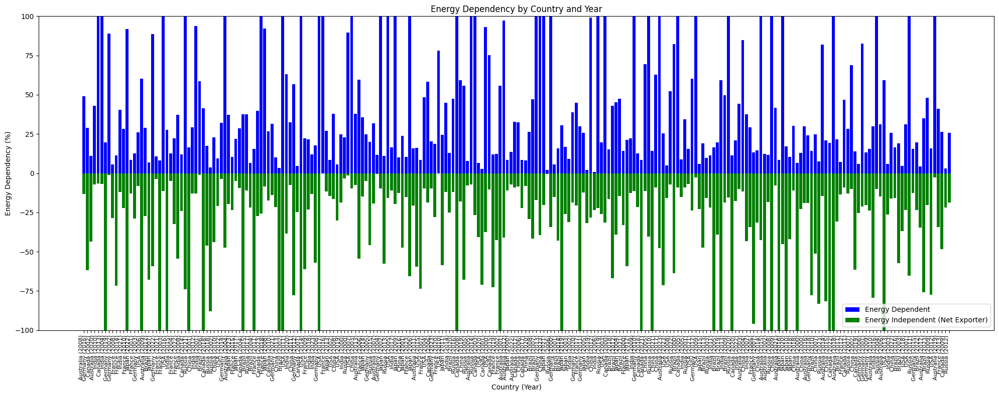

In [5]:
# Separate positive and negative energy dependency
positive_dependency = df[df['energy_dependency'] >= 0]
negative_dependency = df[df['energy_dependency'] < 0]

# Plot the graph
plt.figure(figsize=(20, 8))
plt.bar(positive_dependency['Country'] + ' (' + positive_dependency['Year'].astype(str) + ')',
        positive_dependency['energy_dependency'], color='blue', label='Energy Dependent')
plt.bar(negative_dependency['Country'] + ' (' + negative_dependency['Year'].astype(str) + ')',
        negative_dependency['energy_dependency'], color='green', label='Energy Independent (Net Exporter)')
plt.xlabel('Country (Year)')
plt.ylabel('Energy Dependency (%)')
plt.title('Energy Dependency by Country and Year')
plt.xticks(rotation=90, fontsize=8, ha='right')
plt.ylim(-100, 100)
plt.legend()
plt.tight_layout()
plt.show()


Graph 2: Average Energy Dependency by Country

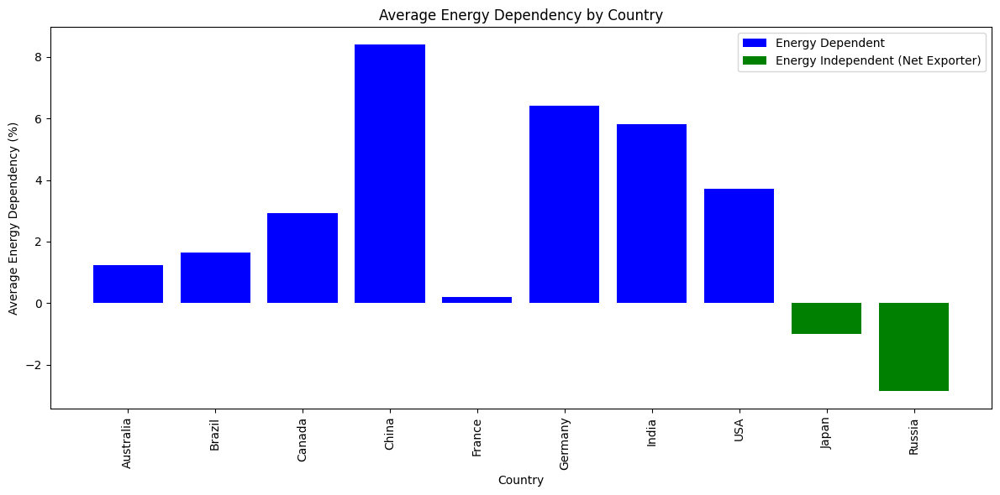

In [6]:
# Group data by country and calculate mean energy dependency
country_data = df.groupby('Country')['energy_dependency'].mean().reset_index()

# Separate positive and negative dependency
positive_dependency = country_data[country_data['energy_dependency'] >= 0]
negative_dependency = country_data[country_data['energy_dependency'] < 0]

# Plot the graph
plt.figure(figsize=(12, 6))
plt.bar(positive_dependency['Country'], positive_dependency['energy_dependency'], color='blue', label='Energy Dependent')
plt.bar(negative_dependency['Country'], negative_dependency['energy_dependency'], color='green', label='Energy Independent (Net Exporter)')
plt.xlabel('Country')
plt.ylabel('Average Energy Dependency (%)')
plt.title('Average Energy Dependency by Country')
plt.xticks(rotation=90)
plt.legend()
plt.tight_layout()
plt.show()


Graph 3: Renewable Energy Production by Country and Energy Type

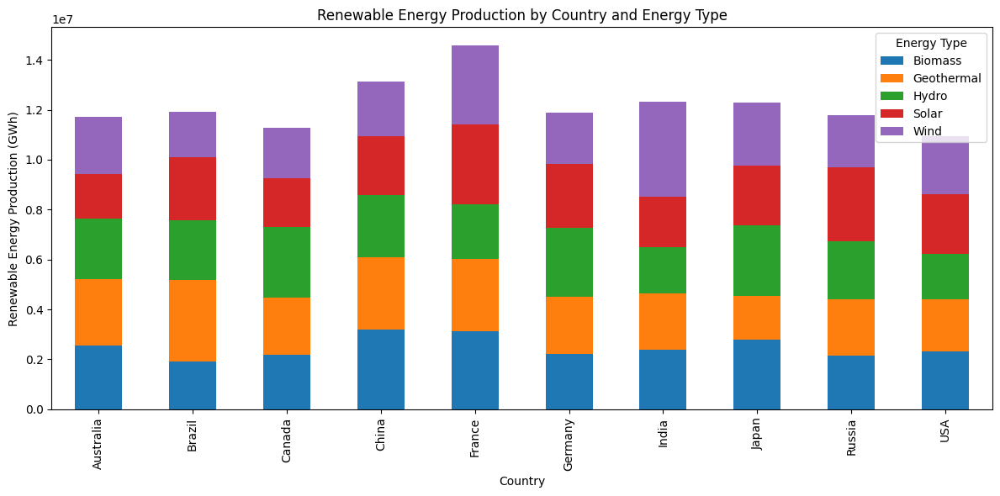

In [7]:
# Group data by country and energy type
country_energy_production = df.groupby(['Country', 'Energy Type'])['Production (GWh)'].sum().reset_index()
energy_matrix = country_energy_production.pivot(index='Country', columns='Energy Type', values='Production (GWh)').fillna(0)

# Plot the stacked bar chart
energy_matrix.plot(kind='bar', stacked=True, figsize=(12, 6))
plt.xlabel('Country')
plt.ylabel('Renewable Energy Production (GWh)')
plt.title('Renewable Energy Production by Country and Energy Type')
plt.xticks(rotation=90)
plt.legend(title='Energy Type')
plt.tight_layout()
plt.show()


Graph 4: Scaled Net Production Rates

In [8]:
# # Calculate net production rates and scaled production
# country_yearly_production = df.groupby(['Country', 'Year'])['Production (GWh)'].sum().reset_index()
# total_production_by_country = country_yearly_production.groupby('Country')['Production (GWh)'].sum().reset_index()
# total_production_all_countries = total_production_by_country['Production (GWh)'].sum()
# total_production_by_country['Net_Production_Rate'] = (total_production_by_country['Production (GWh)'] / total_production_all_countries) * 100
# total_production_by_country['Scaled_Net_Production'] = total_production_by_country['Net_Production_Rate'] * (100 / total_production_by_country['Net_Production_Rate'].max())

# # Plot scaled net production rates
# plt.figure(figsize=(12, 6))
# plt.bar(total_production_by_country['Country'], total_production_by_country['Scaled_Net_Production'], color='green')
# plt.xlabel('Country')
# plt.ylabel('Scaled Net Production')
# plt.title('Net Renewable Energy Production by Country (Scaled)')
# plt.xticks(rotation=45, ha='right')
# plt.tight_layout()
# plt.show()


Geographic Energy Consumption

In [8]:
# Aggregate energy consumption data by country
world_data = df.groupby('Country').agg({
    'Energy Consumption': 'sum',
    'Proportion of Energy from Renewables': 'mean'
}).reset_index()

# Plot the map
fig = px.choropleth(world_data, locations="Country",
                    locationmode='country names',
                    color="Energy Consumption",
                    hover_name="Country",
                    color_continuous_scale='Viridis',
                    title="Global Energy Consumption")
fig.show()


Graph 6: Time Series Analysis

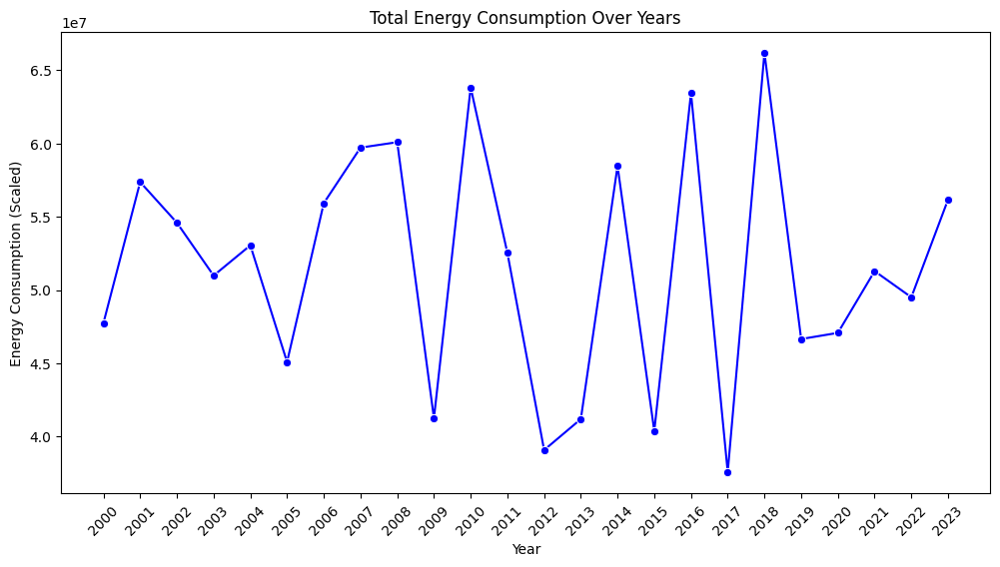

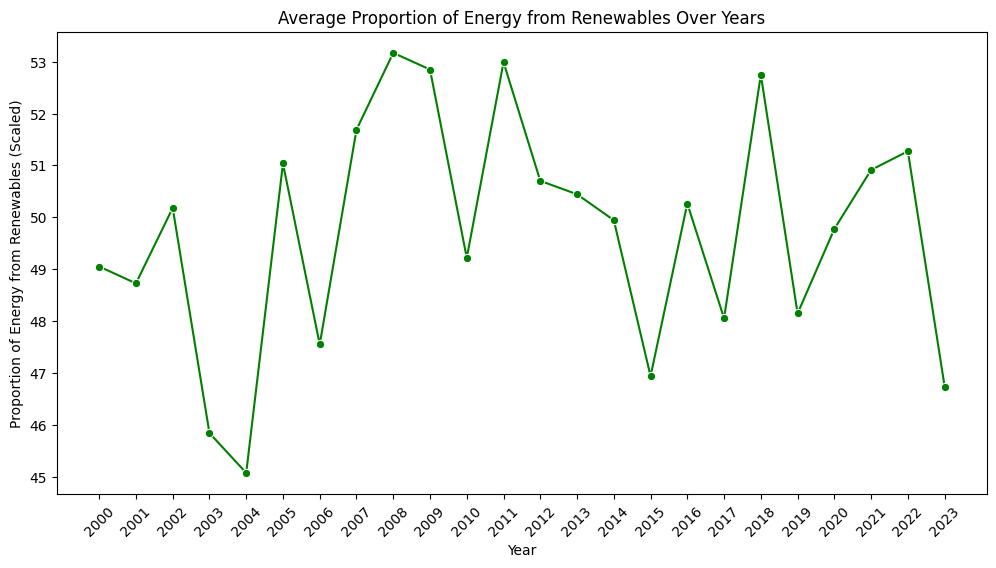

In [9]:
# Aggregate data by year
yearly_data = df.groupby(df['Year']).agg({
    'Energy Consumption': 'sum',
    'Production (GWh)': 'sum',
    'Investments (USD)': 'sum',
    'Proportion of Energy from Renewables': 'mean'
}).reset_index()

# Plot energy consumption trends
plt.figure(figsize=(12, 6))
sns.lineplot(data=yearly_data, x='Year', y='Energy Consumption', marker='o', color='blue')
plt.title('Total Energy Consumption Over Years')
plt.xlabel('Year')
plt.ylabel('Energy Consumption (Scaled)')
plt.xticks(yearly_data['Year'], rotation=45)
plt.show()

# Plot renewable energy proportion trends
plt.figure(figsize=(12, 6))
sns.lineplot(data=yearly_data, x='Year', y='Proportion of Energy from Renewables', marker='o', color='green')
plt.title('Average Proportion of Energy from Renewables Over Years')
plt.xlabel('Year')
plt.ylabel('Proportion of Energy from Renewables (Scaled)')
plt.xticks(yearly_data['Year'], rotation=45)
plt.show()


Increase Local Renewable Energy Production:


Updated Data with CUF:
      Country Energy Type  Production (GWh)  Installed Capacity (MW)       CUF
0        USA       Solar      85404.690027              5549.794323  1.000000
1  Australia  Geothermal      22205.069382             43211.593798  0.058661
2     Canada     Biomass      94102.732038              6139.117212  1.000000
3      Japan     Biomass      88771.932910             40323.639260  0.251311
4      China       Solar      93288.408581             30755.403056  0.346260

Underutilized Energy Sources:
         Country  Year Energy Type  Production (GWh)  Installed Capacity (MW)  \
1     Australia  2008  Geothermal      22205.069382             43211.593798   
3         Japan  2010     Biomass      88771.932910             40323.639260   
6       Germany  2014        Wind       5656.905990             20658.704725   
7       Germany  2016     Biomass      63308.327773             47740.699694   
8         Japan  2015     Biomass      70560.471062             37648.71897

<ipython-input-10-cf440ebdd55d>:35: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




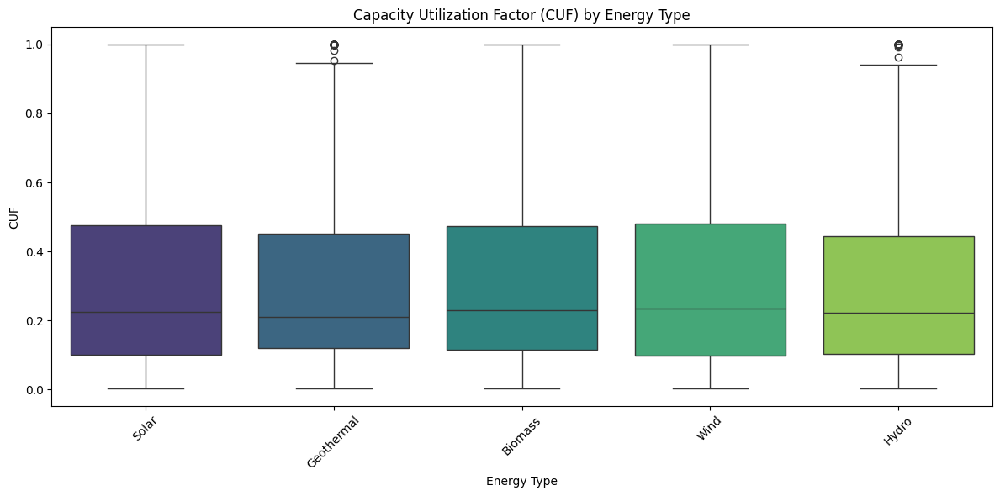


Investment Opportunities:
         Country  Year Energy Type  Production (GWh)  Installed Capacity (MW)  \
6       Germany  2014        Wind       5656.905990             20658.704725   
9        Canada  2002        Wind      57780.099746             22408.241922   
10    Australia  2020       Hydro       3386.115429             39711.897936   
12        Japan  2003       Solar      37917.340622             25327.819719   
14        China  2019       Solar      78755.093746             36288.856249   
...         ...   ...         ...               ...                      ...   
2486  Australia  2002       Hydro       4847.655677             21926.946177   
2487    Germany  2023       Hydro      85415.198394             48447.067697   
2495      Japan  2023       Solar      40091.199325             46650.085012   
2496  Australia  2017       Hydro       9454.189177             28506.752159   
2499     France  2010       Hydro      13035.595344             22890.620016   

      Inves

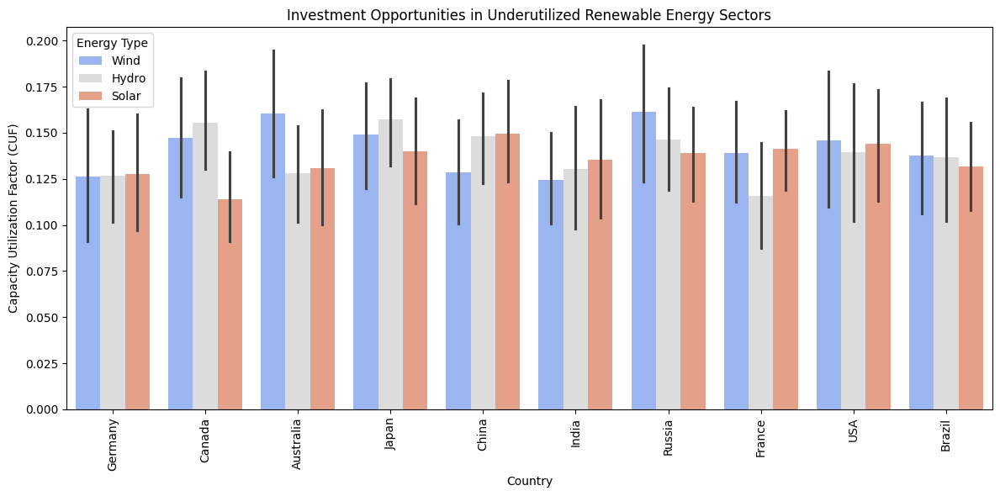

In [10]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns


# Calculate Capacity Utilization Factor (CUF)
def calculate_cuf(data):
    """
    Compute capacity utilization factor for renewable energy sectors.
    CUF = (Production in GWh) / (Installed Capacity in MW * Hours in a Year)
    """
    hours_in_year = 8760  # 24 hours * 365 days
    data['CUF'] = (data['Production (GWh)'] * 1000) / (data['Installed Capacity (MW)'] * hours_in_year)
    data['CUF'] = data['CUF'].fillna(0).clip(upper=1)  # Clip values at 1 to handle data inconsistencies
    return data

df = calculate_cuf(df)
print("\nUpdated Data with CUF:\n", df[['Country', 'Energy Type', 'Production (GWh)', 'Installed Capacity (MW)', 'CUF']].head())

# Analyze Underutilized Energy Sources
def analyze_underutilized_sources(data):
    """
    Filter underutilized renewable energy sources based on CUF thresholds.
    Suggest scaling up sources with low CUF but significant potential.
    """
    # Threshold for low CUF: Below 30% utilization
    underutilized = data[data['CUF'] < 0.3]
    return underutilized

underutilized_sources = analyze_underutilized_sources(df)
print("\nUnderutilized Energy Sources:\n", underutilized_sources)

# Visualize CUF for All Energy Types
plt.figure(figsize=(12, 6))
sns.boxplot(data=df, x='Energy Type', y='CUF', palette='viridis')
plt.title("Capacity Utilization Factor (CUF) by Energy Type")
plt.ylabel("CUF")
plt.xlabel("Energy Type")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Potential Investment Areas
def identify_investment_areas(data):
    """
    Analyze resource potential and CUF to identify scaling-up opportunities.
    Use hypothetical resource data for solar irradiance, wind speed, etc.
    """
    # Adding dummy potential data for demonstration
    data['Solar Irradiance (kWh/m²/day)'] = data['Energy Type'].apply(lambda x: 5.0 if x == 'Solar' else None)
    data['Wind Speed (m/s)'] = data['Energy Type'].apply(lambda x: 7.0 if x == 'Wind' else None)
    data['Hydro Potential (GWh)'] = data['Energy Type'].apply(lambda x: 1000 if x == 'Hydro' else None)

    # Filter sectors with low CUF and significant potential
    investment_opportunities = data[(data['CUF'] < 0.3) &
                                    ((data['Solar Irradiance (kWh/m²/day)'] > 4.5) |
                                     (data['Wind Speed (m/s)'] > 6) |
                                     (data['Hydro Potential (GWh)'] > 500))]
    return investment_opportunities

investment_opportunities = identify_investment_areas(df)
print("\nInvestment Opportunities:\n", investment_opportunities)

# Visualize Investment Opportunities
plt.figure(figsize=(12, 6))
sns.barplot(data=investment_opportunities, x='Country', y='CUF', hue='Energy Type', palette='coolwarm')
plt.title("Investment Opportunities in Underutilized Renewable Energy Sectors")
plt.ylabel("Capacity Utilization Factor (CUF)")
plt.xlabel("Country")
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()


1. Boost Investments and R&D:

In [11]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Initial Checks
print("Dataset Overview:\n", df.head())
print("\nColumns:\n", df.columns)

# Analyze Investments and R&D Expenditure Trends
def analyze_trends(data):
    """
    Evaluate trends in Investments and R&D Expenditure over time.
    """
    trend_data = data.groupby('Year').agg({
        'Investments (USD)': 'sum',
        'R&D Expenditure': 'sum',
        'Production (GWh)': 'sum',
        'Installed Capacity (MW)': 'sum',
        'Grid Integration Capability': 'mean'
    }).reset_index()
    return trend_data

trend_data = analyze_trends(df)
print("\nTrends Overview:\n", trend_data)

# Correlate Investments, R&D, and Energy Metrics
def correlate_metrics(data):
    """
    Analyze the relationship between Investments, R&D, and energy metrics.
    """
    correlation_data = data[['Investments (USD)', 'R&D Expenditure',
                             'Production (GWh)', 'Installed Capacity (MW)',
                             'Grid Integration Capability']].corr()
    return correlation_data

correlation_matrix = correlate_metrics(df)
print("\nCorrelation Matrix:\n", correlation_matrix)

# Identify Target Technologies
def identify_target_areas(data):
    """
    Direct investments toward impactful but underfunded technologies.
    """
    # Filter for underfunded areas with high potential
    target_areas = data.groupby('Energy Type').agg({
        'Investments (USD)': 'mean',
        'R&D Expenditure': 'mean',
        'Installed Capacity (MW)': 'mean',
        'Grid Integration Capability': 'mean',
    }).reset_index()

    # Rank by Grid Integration Capability and Energy Storage
    target_areas['Priority Score'] = target_areas['Grid Integration Capability'] + target_areas['Installed Capacity (MW)']
    target_areas = target_areas.sort_values(by='Priority Score', ascending=False)
    return target_areas

target_areas = identify_target_areas(df)
print("\nTarget Areas for Investment:\n", target_areas)


Dataset Overview:
      Country  Year Energy Type  Production (GWh)  Installed Capacity (MW)  \
0        USA  2011       Solar      85404.690027              5549.794323   
1  Australia  2008  Geothermal      22205.069382             43211.593798   
2     Canada  2013     Biomass      94102.732038              6139.117212   
3      Japan  2010     Biomass      88771.932910             40323.639260   
4      China  2018       Solar      93288.408581             30755.403056   

   Investments (USD)  Population           GDP  Energy Consumption  \
0       5.604125e+09  1064007213  1.775278e+14       369654.644184   
1       6.361886e+08  1033255852  6.435372e+13       771781.636293   
2       6.158680e+09    14895124  1.567926e+14       342707.152899   
3       8.526116e+09  1448827283  1.350464e+14       498839.574253   
4       5.086237e+09  1499494307  8.677956e+13       819064.362785   

   Energy Exports  ...  Energy Sector Workforce  \
0    93087.198199  ...                   51165

1.1Trends in Investments and R&D Expenditure Over Time

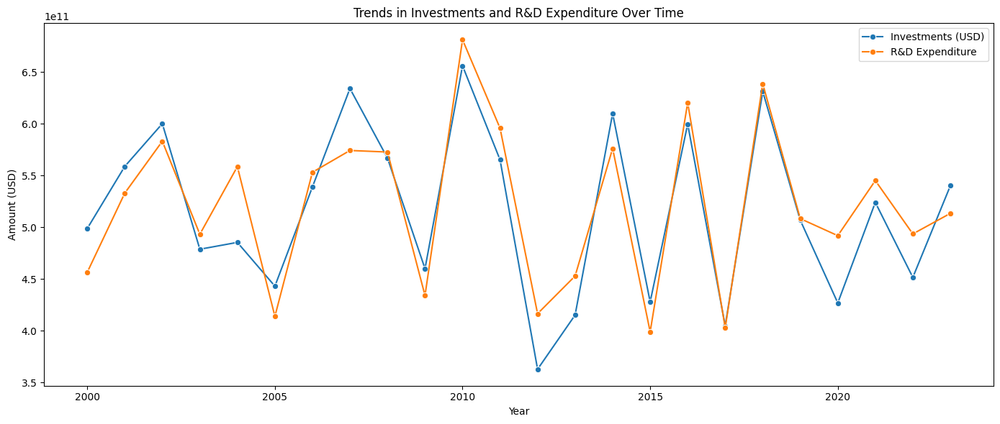

In [12]:
plt.figure(figsize=(14, 6))
sns.lineplot(data=trend_data, x='Year', y='Investments (USD)', marker='o', label='Investments (USD)')
sns.lineplot(data=trend_data, x='Year', y='R&D Expenditure', marker='o', label='R&D Expenditure')
plt.title("Trends in Investments and R&D Expenditure Over Time")
plt.ylabel("Amount (USD)")
plt.xlabel("Year")
plt.legend()
plt.tight_layout()
plt.show()


1.2Correlation Between Investments, R&D, and Energy Metrics

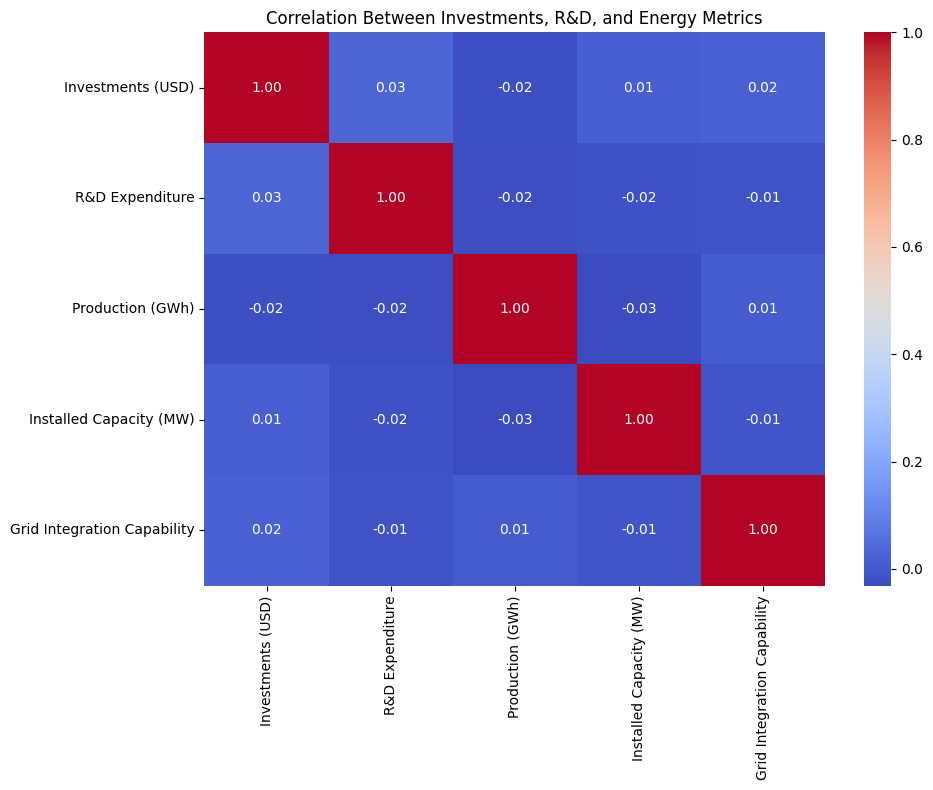

In [13]:
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Correlation Between Investments, R&D, and Energy Metrics")
plt.tight_layout()
plt.show()


1.3Investment Priorities by Energy Type

<ipython-input-14-cc2b8acfd86d>:2: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




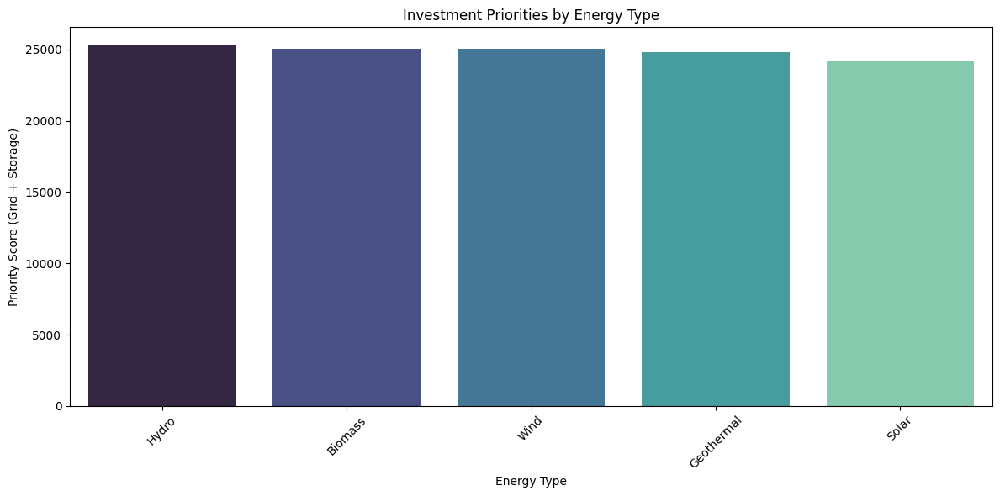

In [14]:
plt.figure(figsize=(12, 6))
sns.barplot(data=target_areas, x='Energy Type', y='Priority Score', palette='mako')
plt.title("Investment Priorities by Energy Type")
plt.ylabel("Priority Score (Grid + Storage)")
plt.xlabel("Energy Type")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


2. Set and Meet Renewable Energy Targets:

In [15]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns



# Ensure column names match expected format
expected_columns = [
    'Country',
    'Renewable Energy Targets',
    'Proportion of Energy from Renewables',
    'Hydro Potential',
    'Solar Irradiance',
    'Wind Speed',
    'Biomass Availability',
    'Geothermal Potential'
]

for col in expected_columns:
    if col not in df.columns:
        print(f"Missing column: {col}")
        raise KeyError(f"Expected column '{col}' is missing from the dataset!")

# Analyze Targets vs Progress
def analyze_renewable_targets(data):
    """
    Analyze the gap between Renewable Energy Targets and Actual Progress.
    """
    target_analysis = data.groupby('Country').agg({
        'Renewable Energy Targets': 'mean',  # Corrected column
        'Proportion of Energy from Renewables': 'mean',  # Actual progress
        'Hydro Potential': 'mean',  # Potential indicators
        'Solar Irradiance': 'mean',
        'Wind Speed': 'mean',
        'Biomass Availability': 'mean',
        'Geothermal Potential': 'mean'
    }).reset_index()

    # Calculate the gap between target and actual progress
    target_analysis['Progress Gap (%)'] = (
        target_analysis['Renewable Energy Targets'] -
        target_analysis['Proportion of Energy from Renewables']
    )

    return target_analysis

# Call the function with the dataset
target_analysis = analyze_renewable_targets(df)

# Display the results
print("\nTarget vs Progress Analysis:\n", target_analysis)

# Adjust Targets Based on Renewable Potential
def adjust_targets(data):
    """
    Suggest target adjustments based on renewable potential.
    """
    data['Adjusted Target (%)'] = (
        data['Renewable Energy Targets'] +
        0.3 * data['Hydro Potential'] +
        0.3 * data['Solar Irradiance'] +
        0.2 * data['Wind Speed'] +
        0.1 * data['Biomass Availability'] +
        0.1 * data['Geothermal Potential']
    )
    data['Adjusted Target (%)'] = data['Adjusted Target (%)'].clip(upper=100)
    return data

adjusted_targets = adjust_targets(target_analysis)
print("\nAdjusted Targets:\n", adjusted_targets[['Country', 'Renewable Energy Targets', 'Adjusted Target (%)']])

# Policy Recommendations
def suggest_policies(data):
    """
    Suggest policy recommendations for countries not meeting targets.
    """
    underperformers = data[data['Progress Gap (%)'] > 10]  # Threshold can be adjusted as needed
    policies = underperformers[['Country', 'Progress Gap (%)']].copy()
    policies['Recommendation'] = "Strengthen incentives for renewables, enhance funding for underutilized resources."
    return policies

policy_recommendations = suggest_policies(target_analysis)
print("\nPolicy Recommendations for Underperformers:\n", policy_recommendations)



Target vs Progress Analysis:
      Country  Renewable Energy Targets  Proportion of Energy from Renewables  \
0  Australia                  0.485714                             52.716070   
1     Brazil                  0.487705                             45.998987   
2     Canada                  0.465812                             48.803394   
3      China                  0.473282                             48.115621   
4     France                  0.503378                             50.893399   
5    Germany                  0.531120                             51.161707   
6      India                  0.526104                             49.626270   
7      Japan                  0.469880                             49.131578   
8     Russia                  0.510204                             50.877819   
9        USA                  0.493617                             50.030260   

   Hydro Potential  Solar Irradiance  Wind Speed  Biomass Availability  \
0        50.76

2.1 Progress Gaps in Meeting Renewable Energy Targets

<ipython-input-16-5135e9a5d296>:2: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




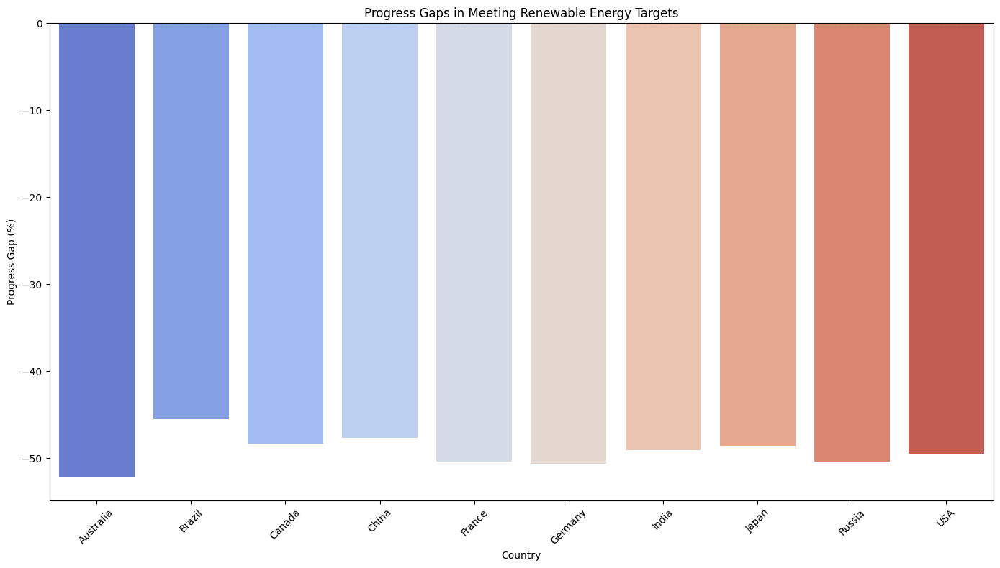

In [16]:
plt.figure(figsize=(14, 8))
sns.barplot(data=target_analysis, x='Country', y='Progress Gap (%)', palette='coolwarm')
plt.axhline(0, color='black', linewidth=0.8, linestyle='--')
plt.title("Progress Gaps in Meeting Renewable Energy Targets")
plt.ylabel("Progress Gap (%)")
plt.xlabel("Country")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


2.2 Adjusted Renewable Energy Targets Based on Potential

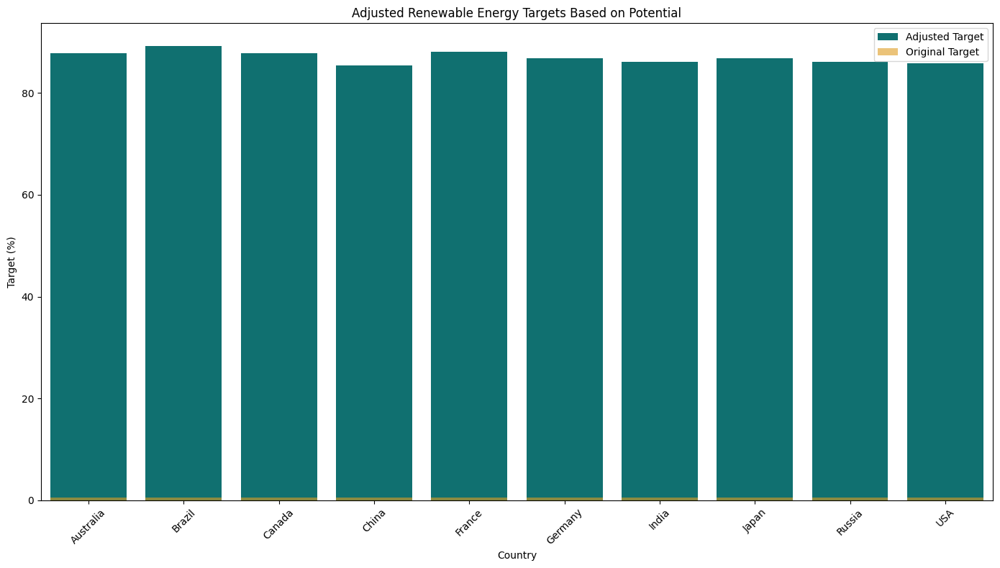

In [17]:
plt.figure(figsize=(14, 8))
sns.barplot(data=adjusted_targets, x='Country', y='Adjusted Target (%)', color='teal', label='Adjusted Target')
sns.barplot(data=adjusted_targets, x='Country', y='Renewable Energy Targets', color='orange', alpha=0.6, label='Original Target')
plt.title("Adjusted Renewable Energy Targets Based on Potential")
plt.ylabel("Target (%)")
plt.xlabel("Country")
plt.xticks(rotation=45)
plt.legend()
plt.tight_layout()
plt.show()


Analyzing Renewable Energy Metrics and Identifying Regional Energy Gaps

In [18]:
# Calculate metrics for analysis
df['Storage Utilization (%)'] = (
    df['Installed Capacity (MW)'] / df['Production (GWh)'] * 100
)

# Substitute for missing 'Curtailment Impact' calculation
df['Curtailment Impact'] = (
    (df['Energy Consumption'] + df['Energy Exports']) * df['Installed Capacity (MW)'] / 100
)

# Highlight regions with significant issues
gaps = df[
    (df['Storage Utilization (%)'] < 20) |  # Low storage utilization
    (df['Energy Exports'] < 5) |  # Poor energy exports
    (df['Curtailment Impact'] > 1000)  # High curtailment
]

# Print results
print("\nRegions with Significant Gaps:\n", gaps)



Regions with Significant Gaps:
         Country  Year Energy Type  Production (GWh)  Installed Capacity (MW)  \
0           USA  2011       Solar      85404.690027              5549.794323   
1     Australia  2008  Geothermal      22205.069382             43211.593798   
2        Canada  2013     Biomass      94102.732038              6139.117212   
3         Japan  2010     Biomass      88771.932910             40323.639260   
4         China  2018       Solar      93288.408581             30755.403056   
...         ...   ...         ...               ...                      ...   
2495      Japan  2023       Solar      40091.199325             46650.085012   
2496  Australia  2017       Hydro       9454.189177             28506.752159   
2497      India  2022  Geothermal      94329.590380             22757.496947   
2498      China  2000     Biomass      66206.311515              3530.005331   
2499     France  2010       Hydro      13035.595344             22890.620016   

      

Visualizing Energy Storage Utilization vs Curtailment Impact Across Countries

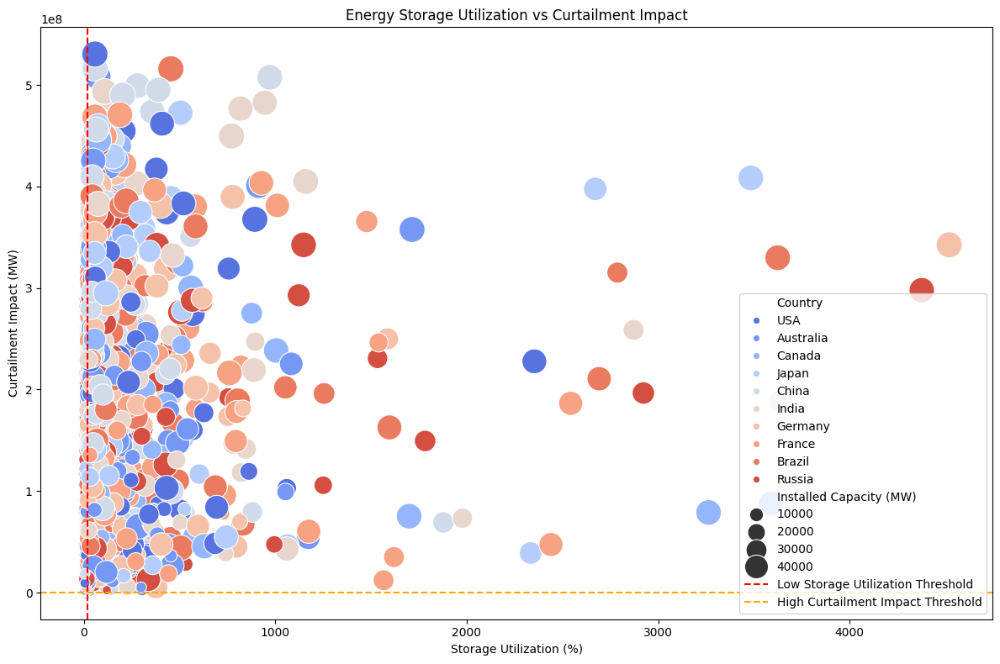

In [19]:
import matplotlib.pyplot as plt
import seaborn as sns

# Ensure required columns are used
size_column = 'Renewable Energy Capacity (MW)' if 'Renewable Energy Capacity (MW)' in df.columns else 'Installed Capacity (MW)'

# Scatter plot for Storage Utilization vs Curtailment Impact
plt.figure(figsize=(12, 8))
sns.scatterplot(
    data=df,
    x='Storage Utilization (%)',
    y='Curtailment Impact',
    hue='Country',
    size=size_column,
    sizes=(50, 500),
    palette='coolwarm'
)

# Threshold lines
plt.axvline(20, color='red', linestyle='--', label='Low Storage Utilization Threshold')
plt.axhline(1000, color='orange', linestyle='--', label='High Curtailment Impact Threshold')

# Title and labels
plt.title("Energy Storage Utilization vs Curtailment Impact")
plt.xlabel("Storage Utilization (%)")
plt.ylabel("Curtailment Impact (MW)")
plt.legend()
plt.tight_layout()

# Show plot
plt.show()


Analysis and Policy Recommendations for Regions with Grid Integration and Curtailment Challenges

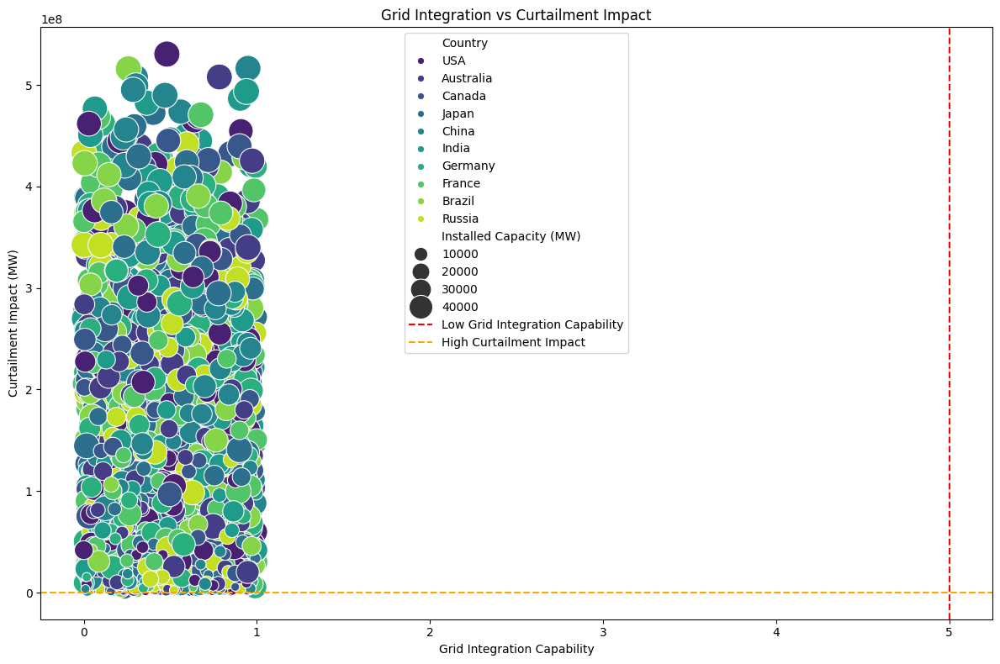


Problematic Regions:
       Country  Year Energy Type  Production (GWh)  Installed Capacity (MW)  \
0         USA  2011       Solar      85404.690027              5549.794323   
2      Canada  2013     Biomass      94102.732038              6139.117212   
13     Brazil  2004  Geothermal      92392.054332              1451.957737   
18     Canada  2013     Biomass      98397.814922             16191.486095   
33     Russia  2020       Hydro      54157.627072               412.701268   
...       ...   ...         ...               ...                      ...   
2477  Germany  2005       Solar      47168.340819              7705.691426   
2483   Russia  2012       Hydro      95252.260774             12308.392930   
2489   Russia  2013        Wind      99313.351110             16694.555680   
2491      USA  2020       Solar      43242.903604              2809.528109   
2498    China  2000     Biomass      66206.311515              3530.005331   

      Investments (USD)  Population     

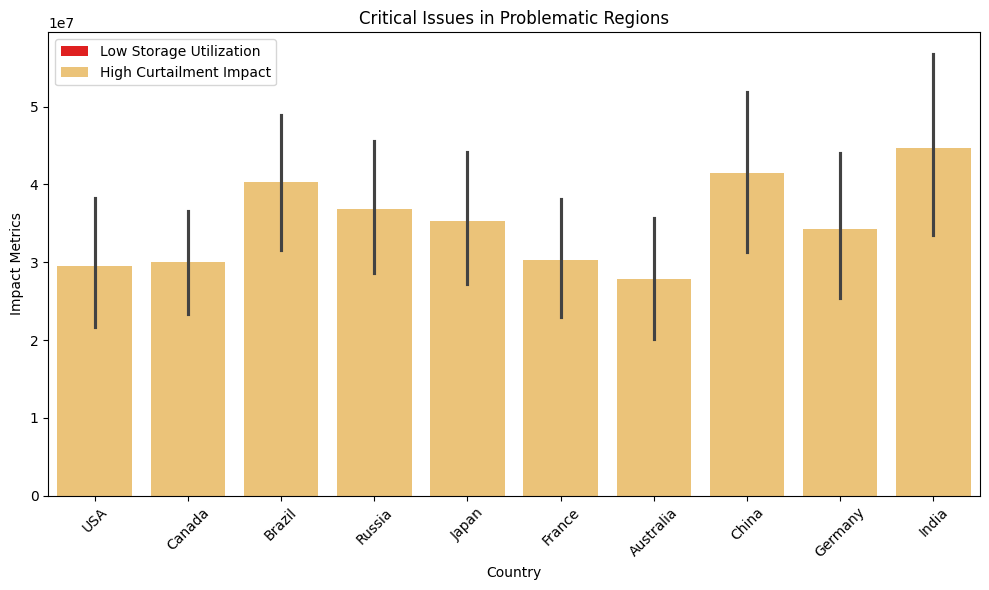


Policy Recommendations:
       Country                              Policy Recommendation
0         USA  1. Invest in energy storage technologies.\n2. ...
2      Canada  1. Invest in energy storage technologies.\n2. ...
13     Brazil  1. Invest in energy storage technologies.\n2. ...
18     Canada  1. Invest in energy storage technologies.\n2. ...
33     Russia  1. Invest in energy storage technologies.\n2. ...
...       ...                                                ...
2477  Germany  1. Invest in energy storage technologies.\n2. ...
2483   Russia  1. Invest in energy storage technologies.\n2. ...
2489   Russia  1. Invest in energy storage technologies.\n2. ...
2491      USA  1. Invest in energy storage technologies.\n2. ...
2498    China  1. Invest in energy storage technologies.\n2. ...

[498 rows x 2 columns]


In [20]:
import matplotlib.pyplot as plt
import seaborn as sns

# Scatter plot for Grid Integration Capability vs Curtailment Impact
plt.figure(figsize=(12, 8))
sns.scatterplot(
    data=df,
    x='Grid Integration Capability',
    y='Curtailment Impact',
    hue='Country',
    size='Installed Capacity (MW)',
    sizes=(50, 500),
    palette='viridis'
)
plt.axvline(5, color='red', linestyle='--', label='Low Grid Integration Capability')
plt.axhline(1000, color='orange', linestyle='--', label='High Curtailment Impact')
plt.title("Grid Integration vs Curtailment Impact")
plt.xlabel("Grid Integration Capability")
plt.ylabel("Curtailment Impact (MW)")
plt.legend()
plt.tight_layout()
plt.show()

# Filter problematic regions
problematic_regions = df[
    (df['Storage Utilization (%)'] < 20) &
    (df['Curtailment Impact'] > 1000) &
    (df['Grid Integration Capability'] < 5)
]
print("\nProblematic Regions:\n", problematic_regions)

# Bar plot for critical issues in problematic regions
plt.figure(figsize=(10, 6))
sns.barplot(data=problematic_regions, x='Country', y='Storage Utilization (%)', color='red', label='Low Storage Utilization')
sns.barplot(data=problematic_regions, x='Country', y='Curtailment Impact', color='orange', alpha=0.6, label='High Curtailment Impact')
plt.title("Critical Issues in Problematic Regions")
plt.ylabel("Impact Metrics")
plt.xlabel("Country")
plt.xticks(rotation=45)
plt.legend()
plt.tight_layout()
plt.show()

# Generate policy recommendations
def recommend_policies(data):
    recommendations = data[['Country']].copy()
    recommendations['Policy Recommendation'] = (
        "1. Invest in energy storage technologies.\n"
        "2. Enhance grid connectivity with smart grids.\n"
        "3. Promote distributed renewable generation and storage."
    )
    return recommendations

policy_recommendations = recommend_policies(problematic_regions)
print("\nPolicy Recommendations:\n", policy_recommendations)



6.Develop Renewable Energy Jobs and Education:


Summary Statistics:
        Renewable Energy Jobs  Educational Level  \
count            2500.000000        2500.000000   
mean           502896.083600           4.975377   
std            286748.983941           2.885123   
min              1320.000000           0.000731   
25%            253688.750000           2.470056   
50%            497165.500000           4.983848   
75%            754547.000000           7.474700   
max            999562.000000           9.997990   

       Renewable Energy Education Programs  
count                          2500.000000  
mean                              0.506800  
std                               0.500054  
min                               0.000000  
25%                               0.000000  
50%                               1.000000  
75%                               1.000000  
max                               1.000000  


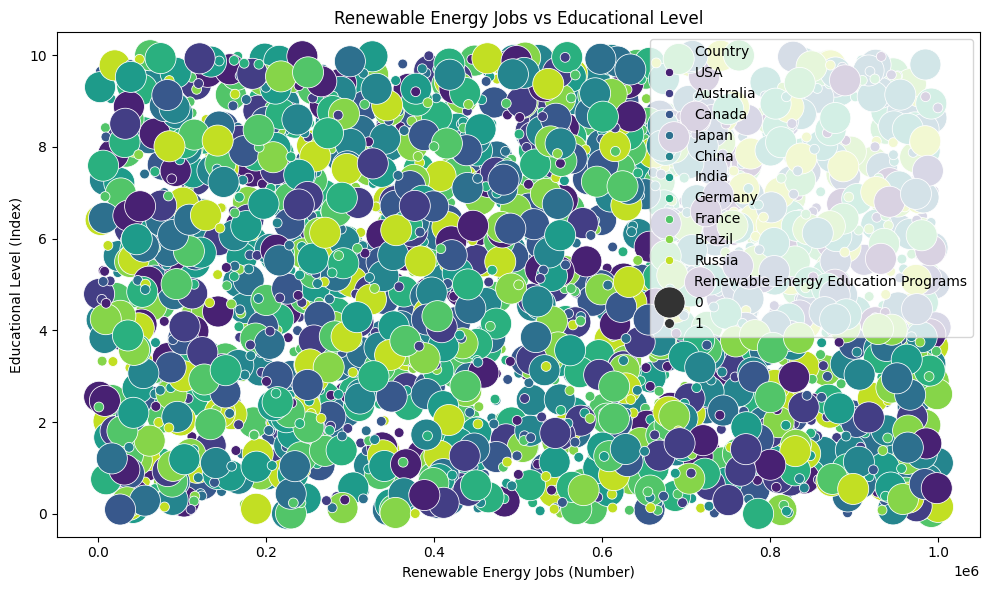


Correlation Matrix:
                                      Renewable Energy Jobs  Educational Level  \
Renewable Energy Jobs                             1.000000          -0.038253   
Educational Level                                -0.038253           1.000000   
Renewable Energy Education Programs              -0.005870          -0.020499   

                                     Renewable Energy Education Programs  
Renewable Energy Jobs                                          -0.005870  
Educational Level                                              -0.020499  
Renewable Energy Education Programs                             1.000000  


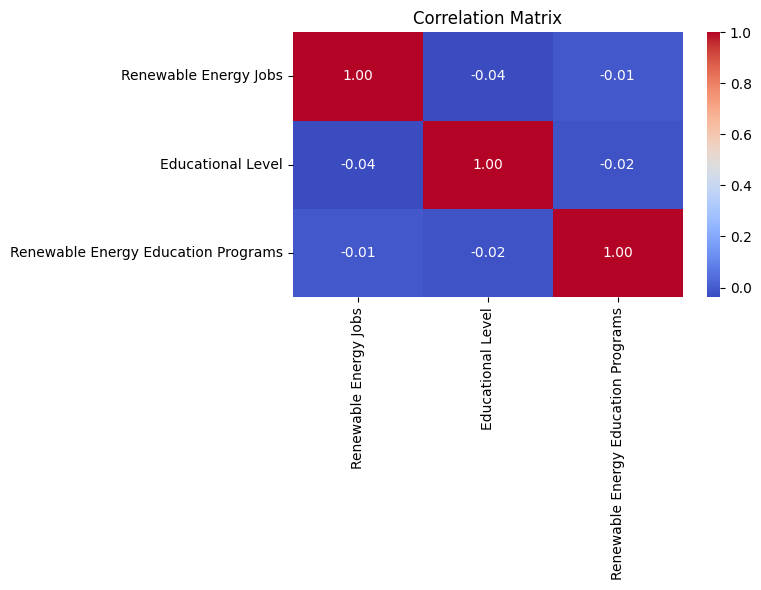


Underdeveloped Regions:
       Country  Renewable Energy Jobs  Educational Level  \
3       Japan                  11049           4.590746   
4       China                 225191           0.001750   
8       Japan                 339831           3.892325   
11     France                 436217           2.077438   
19     Canada                 230374           1.905470   
...       ...                    ...                ...   
2436      USA                 388499           0.409032   
2444   Canada                 349688           2.556117   
2450  Germany                 328050           3.000658   
2467    Japan                  16745           1.208026   
2472   France                 365926           3.769835   

      Renewable Energy Education Programs  
3                                       0  
4                                       0  
8                                       0  
11                                      0  
19                                      0  
.

In [21]:
import matplotlib.pyplot as plt
import seaborn as sns

# Summary statistics
summary_stats = df[['Renewable Energy Jobs', 'Educational Level', 'Renewable Energy Education Programs']].describe()
print("\nSummary Statistics:\n", summary_stats)

# Scatter plot: Renewable Energy Jobs vs Educational Level
plt.figure(figsize=(10, 6))
sns.scatterplot(
    data=df,
    x='Renewable Energy Jobs',
    y='Educational Level',
    hue='Country',
    palette='viridis',
    size='Renewable Energy Education Programs',
    sizes=(50, 500)
)
plt.title("Renewable Energy Jobs vs Educational Level")
plt.xlabel("Renewable Energy Jobs (Number)")
plt.ylabel("Educational Level (Index)")
plt.tight_layout()
plt.show()

# Correlation analysis
correlation_matrix = df[['Renewable Energy Jobs', 'Educational Level', 'Renewable Energy Education Programs']].corr()
print("\nCorrelation Matrix:\n", correlation_matrix)

# Heatmap of correlation matrix
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Matrix')
plt.tight_layout()
plt.show()

# Identify underdeveloped regions
underdeveloped_regions = df[
    (df['Renewable Energy Jobs'] < df['Renewable Energy Jobs'].median()) &
    (df['Educational Level'] < df['Educational Level'].median()) &
    (df['Renewable Energy Education Programs'] < df['Renewable Energy Education Programs'].median())
]
print("\nUnderdeveloped Regions:\n", underdeveloped_regions[['Country', 'Renewable Energy Jobs', 'Educational Level', 'Renewable Energy Education Programs']])

# Generate recommendations
def recommend_training(data):
    recommendations = data[['Country']].copy()
    recommendations['Policy Recommendation'] = (
        "1. Increase investment in renewable energy job creation.\n"
        "2. Expand educational programs focusing on renewable energy technologies.\n"
        "3. Establish public-private partnerships for workforce training.\n"
        "4. Collaborate with international renewable energy education programs."
    )
    return recommendations

training_recommendations = recommend_training(underdeveloped_regions)
print("\nTraining Recommendations:\n", training_recommendations)




Feature Engineering Model: “Predicting Future R&D Expenditure (2027-2032) Using Machine Learning Models: Polynomial Regression, Random Forest, and Gradient Boosting”

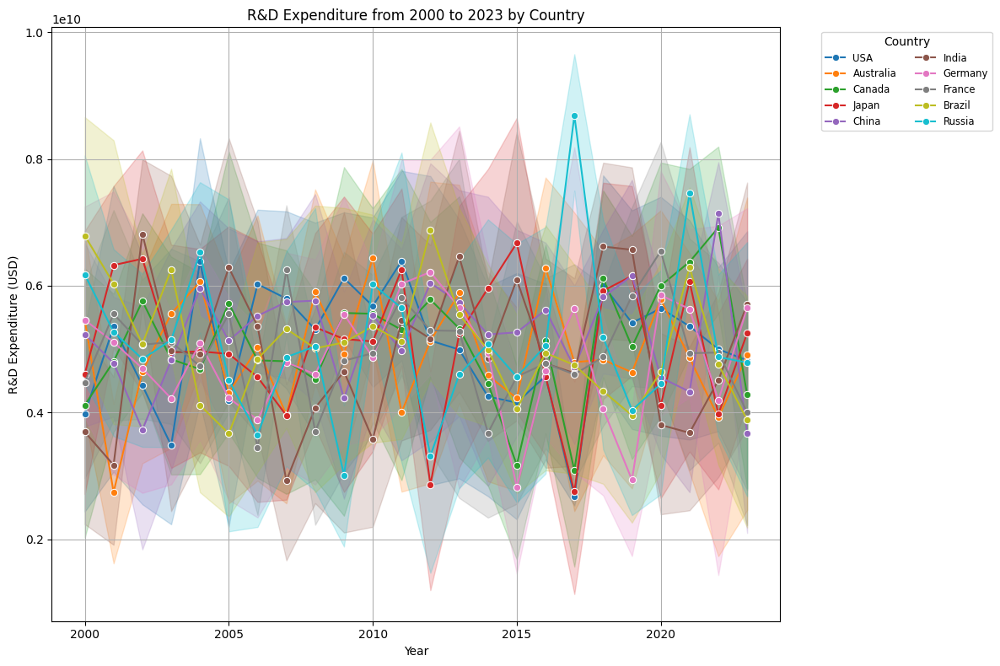


Future R&D Expenditure Predictions:
      Country Energy Type  Gradient Boosting 2027  Gradient Boosting 2030  \
0   Australia     Biomass            4.767396e+09            4.767396e+09   
1   Australia  Geothermal            5.962781e+09            5.962781e+09   
2   Australia       Hydro            4.996216e+09            4.996216e+09   
3   Australia       Solar            5.997406e+09            5.997406e+09   
4   Australia        Wind            3.665130e+09            3.665130e+09   
5      Brazil     Biomass            5.420637e+09            5.420637e+09   
6      Brazil  Geothermal            4.026473e+09            4.026473e+09   
7      Brazil       Hydro            4.140693e+09            4.140693e+09   
8      Brazil       Solar            4.876337e+09            4.876337e+09   
9      Brazil        Wind            4.522539e+09            4.522539e+09   
10     Canada     Biomass            5.749653e+09            5.749653e+09   
11     Canada  Geothermal            4.

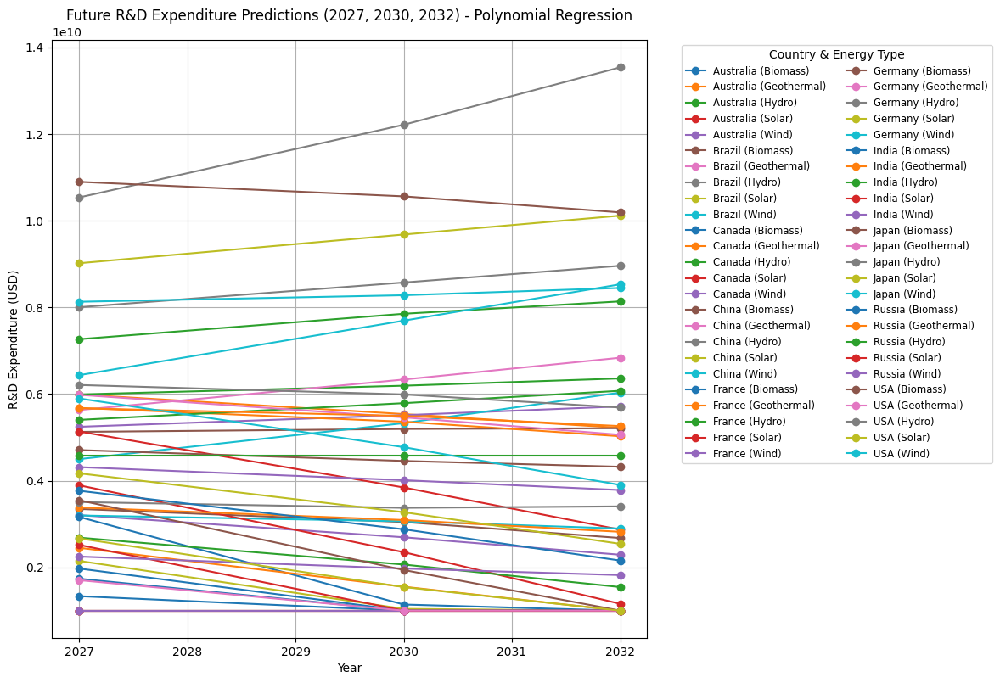

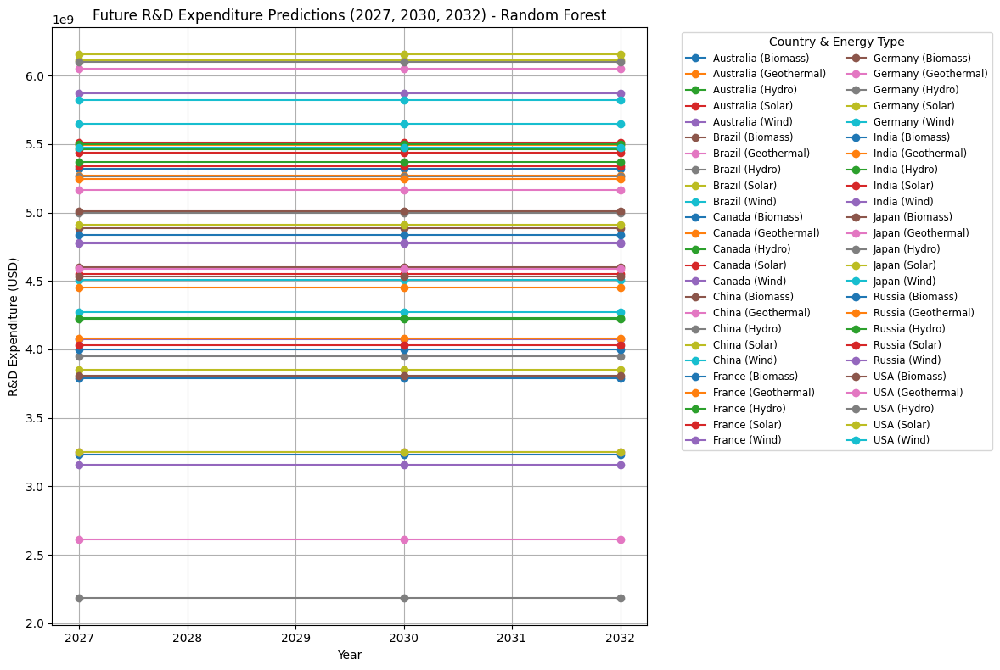

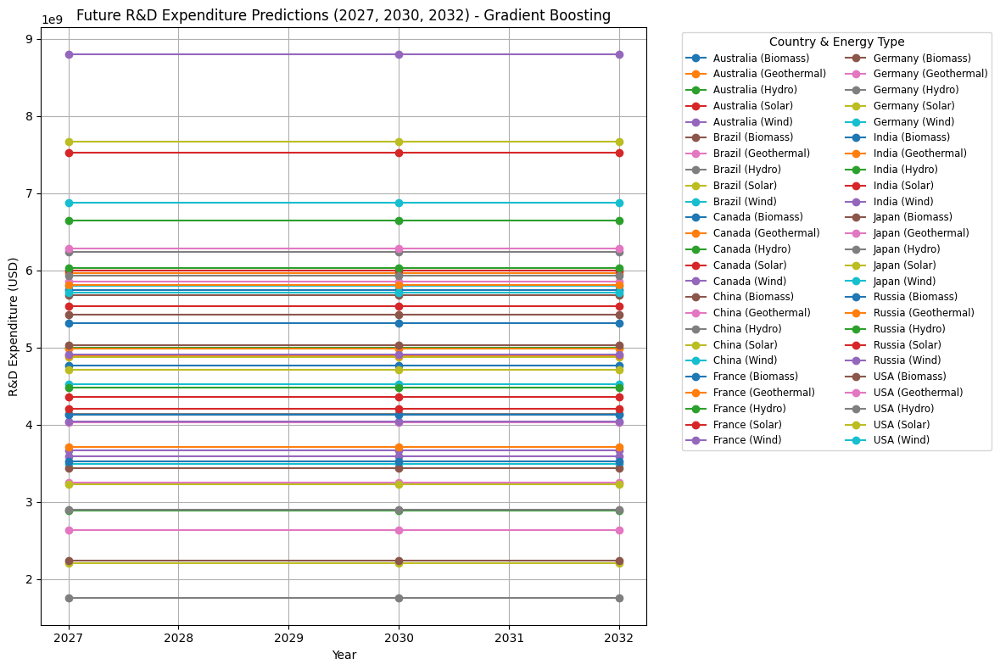

In [22]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures


df_filtered = df[(df['Year'] >= 2000) & (df['Year'] <= 2023)].copy()
df_filtered['Year'] = df_filtered['Year'].astype(int)
df_filtered['R&D Expenditure'] = pd.to_numeric(df_filtered['R&D Expenditure'], errors='coerce')

# Historical Data Visualization
plt.figure(figsize=(12, 8))
sns.lineplot(data=df_filtered, x='Year', y='R&D Expenditure', hue='Country', marker='o')
plt.title('R&D Expenditure from 2000 to 2023 by Country')
plt.xlabel('Year')
plt.ylabel('R&D Expenditure (USD)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left', ncol=2, fontsize='small')
plt.grid(True)
plt.tight_layout()
plt.show()

# Prepare Data for Model Training
features = ['Year', 'Population', 'GDP', 'Innovation Index', 'Urbanization Rate']
target = 'R&D Expenditure'

categorical_features = ['Country', 'Energy Type']
numeric_features = [col for col in features if col not in categorical_features]

X = df[features + categorical_features].copy()
y = df[target]

# Train-Test Split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Preprocessor
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), numeric_features),
        ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features)
    ])

# Models: Polynomial Regression, Random Forest, Gradient Boosting
# Polynomial Regression Pipeline
poly_features = PolynomialFeatures(degree=3)
poly_model = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('poly', poly_features),
    ('linear_model', LinearRegression())
])

# Random Forest Pipeline
random_forest_model = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('model', RandomForestRegressor(n_estimators=500, random_state=42))
])

# Gradient Boosting Pipeline
gradient_boosting_model = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('model', GradientBoostingRegressor(n_estimators=500, random_state=42))
])

# Fit the models
poly_model.fit(X_train, y_train)
random_forest_model.fit(X_train, y_train)
gradient_boosting_model.fit(X_train, y_train)

# Predict Future R&D Expenditure (2027, 2030, 2032) with all models
future_years = [2027, 2030, 2032]
future_predictions = []

for country in df['Country'].unique():
    for energy_type in df['Energy Type'].unique():
        last_values = X[(X['Country'] == country) & (X['Energy Type'] == energy_type)].tail(1)
        if not last_values.empty:
            for year in future_years:
                future_features = last_values.copy()
                future_features['Year'] = year
                # Adjust other features (e.g., growth rates)
                future_features['Population'] *= 1.02  # Assume 2% growth
                future_features['GDP'] *= 1.03         # Assume 3% growth
                future_features['Innovation Index'] += 0.1  # Increment innovation index

                # Predictions for all models
                poly_pred = poly_model.predict(future_features)[0]
                rf_pred = random_forest_model.predict(future_features)[0]
                gb_pred = gradient_boosting_model.predict(future_features)[0]

                # Store predictions in a list (including country, energy type, and model predictions)
                future_predictions.append({
                    'Country': country,
                    'Energy Type': energy_type,
                    'Year': year,
                    'Polynomial Regression': max(poly_pred, 1e9),
                    'Random Forest': max(rf_pred, 1e9),
                    'Gradient Boosting': max(gb_pred, 1e9),
                })

# Convert the list of predictions into a DataFrame
future_df = pd.DataFrame(future_predictions)

# Pivot the DataFrame to have separate columns for each year and model
future_df = future_df.pivot_table(
    index=['Country', 'Energy Type'],
    columns='Year',
    values=['Polynomial Regression', 'Random Forest', 'Gradient Boosting']
)

# Flatten the multi-level columns and reset the index
future_df.columns = [f'{model} {year}' for model, year in future_df.columns]
future_df.reset_index(inplace=True)

# Display future predictions
print("\nFuture R&D Expenditure Predictions:")
print(future_df)

# Future Predictions Visualization for Polynomial Regression
plt.figure(figsize=(12, 8))
for _, row in future_df.iterrows():
    # Extract years and their corresponding predictions
    years = [2027, 2030, 2032]
    predictions_poly = row[['Polynomial Regression 2027', 'Polynomial Regression 2030', 'Polynomial Regression 2032']].values

    # Plot the predictions for each country and energy type combination
    plt.plot(years, predictions_poly, marker='o', label=f"{row['Country']} ({row['Energy Type']})")

plt.title("Future R&D Expenditure Predictions (2027, 2030, 2032) - Polynomial Regression")
plt.xlabel("Year")
plt.ylabel("R&D Expenditure (USD)")
plt.legend(title='Country & Energy Type', bbox_to_anchor=(1.05, 1), loc='upper left', ncol=2, fontsize='small')
plt.grid(True)
plt.tight_layout()
plt.show()

# Future Predictions Visualization for Random Forest
plt.figure(figsize=(12, 8))
for _, row in future_df.iterrows():
    # Extract years and their corresponding predictions
    years = [2027, 2030, 2032]
    predictions_rf = row[['Random Forest 2027', 'Random Forest 2030', 'Random Forest 2032']].values

    # Plot the predictions for each country and energy type combination
    plt.plot(years, predictions_rf, marker='o', label=f"{row['Country']} ({row['Energy Type']})")

plt.title("Future R&D Expenditure Predictions (2027, 2030, 2032) - Random Forest")
plt.xlabel("Year")
plt.ylabel("R&D Expenditure (USD)")
plt.legend(title='Country & Energy Type', bbox_to_anchor=(1.05, 1), loc='upper left', ncol=2, fontsize='small')
plt.grid(True)
plt.tight_layout()
plt.show()

# Future Predictions Visualization for Gradient Boosting
plt.figure(figsize=(12, 8))
for _, row in future_df.iterrows():
    # Extract years and their corresponding predictions
    years = [2027, 2030, 2032]
    predictions_gb = row[['Gradient Boosting 2027', 'Gradient Boosting 2030', 'Gradient Boosting 2032']].values

    # Plot the predictions for each country and energy type combination
    plt.plot(years, predictions_gb, marker='o', label=f"{row['Country']} ({row['Energy Type']})")

plt.title("Future R&D Expenditure Predictions (2027, 2030, 2032) - Gradient Boosting")
plt.xlabel("Year")
plt.ylabel("R&D Expenditure (USD)")
plt.legend(title='Country & Energy Type', bbox_to_anchor=(1.05, 1), loc='upper left', ncol=2, fontsize='small')
plt.grid(True)
plt.tight_layout()
plt.show()


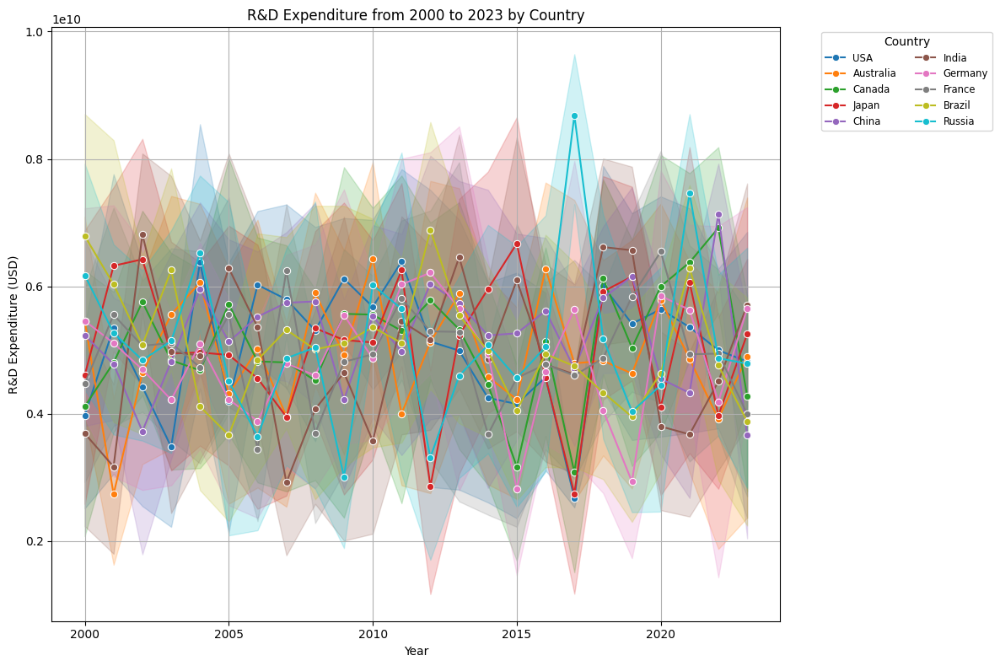

Performance Metrics:
Polynomial Regression - MSE: 12368115922921560064.00, R²: -0.60
Random Forest - MSE: 8089491763387770880.00, R²: -0.04
Gradient Boosting - MSE: 9196274836782444544.00, R²: -0.19

Future R&D Expenditure Predictions:
      Country Energy Type  Gradient Boosting 2027  Gradient Boosting 2030  \
0   Australia     Biomass            4.767396e+09            4.767396e+09   
1   Australia  Geothermal            5.962781e+09            5.962781e+09   
2   Australia       Hydro            4.996216e+09            4.996216e+09   
3   Australia       Solar            5.997406e+09            5.997406e+09   
4   Australia        Wind            3.665130e+09            3.665130e+09   
5      Brazil     Biomass            5.420637e+09            5.420637e+09   
6      Brazil  Geothermal            4.026473e+09            4.026473e+09   
7      Brazil       Hydro            4.140693e+09            4.140693e+09   
8      Brazil       Solar            4.876337e+09            4.876337e+

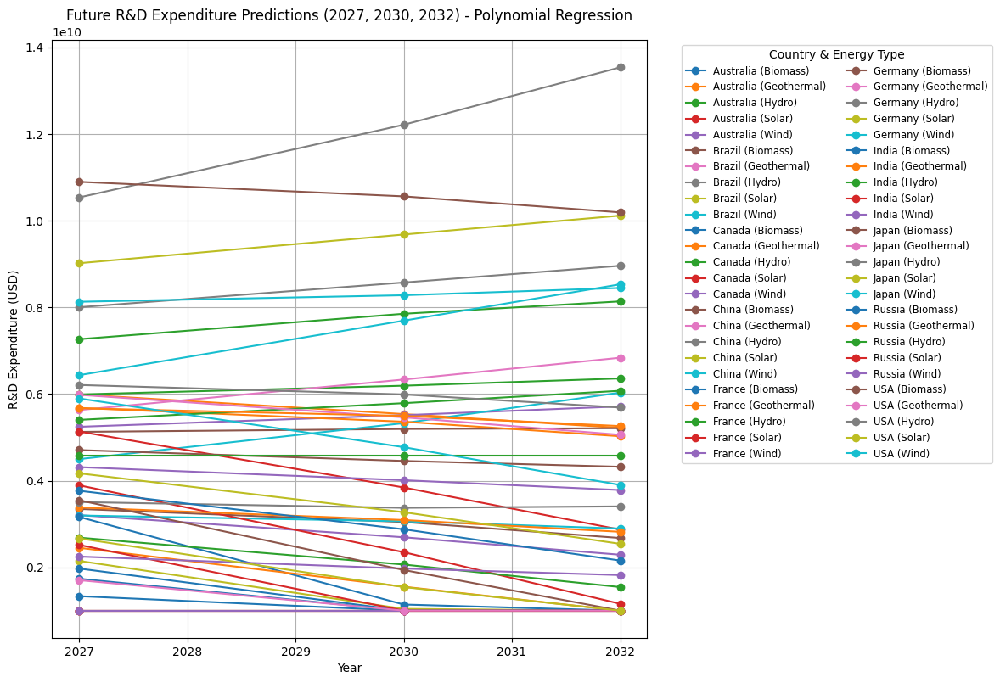

In [23]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, OneHotEncoder, PolynomialFeatures
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score


# Filter data from 2000 to 2023
df_filtered = df[(df['Year'] >= 2000) & (df['Year'] <= 2023)].copy()
df_filtered['Year'] = df_filtered['Year'].astype(int)
df_filtered['R&D Expenditure'] = pd.to_numeric(df_filtered['R&D Expenditure'], errors='coerce')

# Historical Data Visualization
plt.figure(figsize=(12, 8))
sns.lineplot(data=df_filtered, x='Year', y='R&D Expenditure', hue='Country', marker='o')
plt.title('R&D Expenditure from 2000 to 2023 by Country')
plt.xlabel('Year')
plt.ylabel('R&D Expenditure (USD)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left', ncol=2, fontsize='small')
plt.grid(True)
plt.tight_layout()
plt.show()

# Prepare Data for Model Training
features = ['Year', 'Population', 'GDP', 'Innovation Index', 'Urbanization Rate']
target = 'R&D Expenditure'

categorical_features = ['Country', 'Energy Type']
numeric_features = [col for col in features if col not in categorical_features]

X = df[features + categorical_features].copy()
y = df[target]

# Train-Test Split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Preprocessor
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), numeric_features),
        ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features)
    ])

# Models: Polynomial Regression, Random Forest, Gradient Boosting
# Polynomial Regression Pipeline
poly_features = PolynomialFeatures(degree=3)
poly_model = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('poly', poly_features),
    ('linear_model', LinearRegression())
])

# Random Forest Pipeline
random_forest_model = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('model', RandomForestRegressor(n_estimators=500, random_state=42))
])

# Gradient Boosting Pipeline
gradient_boosting_model = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('model', GradientBoostingRegressor(n_estimators=500, random_state=42))
])

# Fit the models
poly_model.fit(X_train, y_train)
random_forest_model.fit(X_train, y_train)
gradient_boosting_model.fit(X_train, y_train)

# Predict on the test set
y_test_poly_pred = poly_model.predict(X_test)
y_test_rf_pred = random_forest_model.predict(X_test)
y_test_gb_pred = gradient_boosting_model.predict(X_test)

# Calculate Mean Square Error (MSE) and R² for each model
mse_poly = mean_squared_error(y_test, y_test_poly_pred)
r2_poly = r2_score(y_test, y_test_poly_pred)

mse_rf = mean_squared_error(y_test, y_test_rf_pred)
r2_rf = r2_score(y_test, y_test_rf_pred)

mse_gb = mean_squared_error(y_test, y_test_gb_pred)
r2_gb = r2_score(y_test, y_test_gb_pred)

# Display results
print("Performance Metrics:")
print(f"Polynomial Regression - MSE: {mse_poly:.2f}, R²: {r2_poly:.2f}")
print(f"Random Forest - MSE: {mse_rf:.2f}, R²: {r2_rf:.2f}")
print(f"Gradient Boosting - MSE: {mse_gb:.2f}, R²: {r2_gb:.2f}")

# Predict Future R&D Expenditure (2027, 2030, 2032) with all models
future_years = [2027, 2030, 2032]
future_predictions = []

for country in df['Country'].unique():
    for energy_type in df['Energy Type'].unique():
        last_values = X[(X['Country'] == country) & (X['Energy Type'] == energy_type)].tail(1)
        if not last_values.empty:
            for year in future_years:
                future_features = last_values.copy()
                future_features['Year'] = year
                # Adjust other features (e.g., growth rates)
                future_features['Population'] *= 1.02  # Assume 2% growth
                future_features['GDP'] *= 1.03         # Assume 3% growth
                future_features['Innovation Index'] += 0.1  # Increment innovation index

                # Predictions for all models
                poly_pred = poly_model.predict(future_features)[0]
                rf_pred = random_forest_model.predict(future_features)[0]
                gb_pred = gradient_boosting_model.predict(future_features)[0]

                # Store predictions in a list (including country, energy type, and model predictions)
                future_predictions.append({
                    'Country': country,
                    'Energy Type': energy_type,
                    'Year': year,
                    'Polynomial Regression': max(poly_pred, 1e9),
                    'Random Forest': max(rf_pred, 1e9),
                    'Gradient Boosting': max(gb_pred, 1e9),
                })

# Convert the list of predictions into a DataFrame
future_df = pd.DataFrame(future_predictions)

# Pivot the DataFrame to have separate columns for each year and model
future_df = future_df.pivot_table(
    index=['Country', 'Energy Type'],
    columns='Year',
    values=['Polynomial Regression', 'Random Forest', 'Gradient Boosting']
)

# Flatten the multi-level columns and reset the index
future_df.columns = [f'{model} {year}' for model, year in future_df.columns]
future_df.reset_index(inplace=True)

# Display future predictions
print("\nFuture R&D Expenditure Predictions:")
print(future_df)

# Future Predictions Visualization for Polynomial Regression
plt.figure(figsize=(12, 8))
for _, row in future_df.iterrows():
    # Extract years and their corresponding predictions
    years = [2027, 2030, 2032]
    predictions_poly = row[['Polynomial Regression 2027', 'Polynomial Regression 2030', 'Polynomial Regression 2032']].values

    # Plot the predictions for each country and energy type combination
    plt.plot(years, predictions_poly, marker='o', label=f"{row['Country']} ({row['Energy Type']})")

plt.title("Future R&D Expenditure Predictions (2027, 2030, 2032) - Polynomial Regression")
plt.xlabel("Year")
plt.ylabel("R&D Expenditure (USD)")
plt.legend(title='Country & Energy Type', bbox_to_anchor=(1.05, 1), loc='upper left', ncol=2, fontsize='small')
plt.grid(True)
plt.tight_layout()
plt.show()

# Similar plots for Random Forest and Gradient Boosting can be added.


LSTM Implementation

In [25]:
!pip install torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu118

Looking in indexes: https://download.pytorch.org/whl/cu118


LSTM for R&D Expenditure

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning:

The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.



Epoch 0: Train Loss: 1.000142, Val Loss: 0.985210
Epoch 10: Train Loss: 1.001250, Val Loss: 0.982077
Epoch 20: Train Loss: 1.006617, Val Loss: 0.985598
Epoch 30: Train Loss: 1.001907, Val Loss: 0.986596
Epoch 40: Train Loss: 0.997993, Val Loss: 0.986867
Epoch 50: Train Loss: 1.000275, Val Loss: 0.986954
Epoch 60: Train Loss: 0.998492, Val Loss: 0.986992
Epoch 70: Train Loss: 0.998323, Val Loss: 0.987003
Epoch 80: Train Loss: 1.002302, Val Loss: 0.987007
Epoch 90: Train Loss: 0.998409, Val Loss: 0.987008


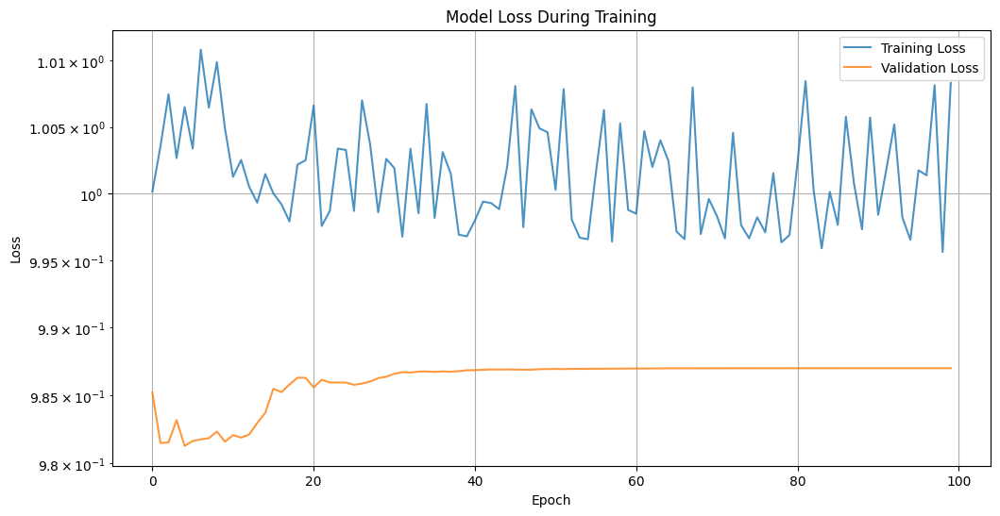


Model Performance Metrics:
Training MSE: 8,282,331,920,478,502,912.00
Test MSE: 8,188,184,038,326,927,360.00
Training MAE: 2,495,168,768.00
Test MAE: 2,452,555,776.00
Training R²: 0.0035
Test R²: -0.0058


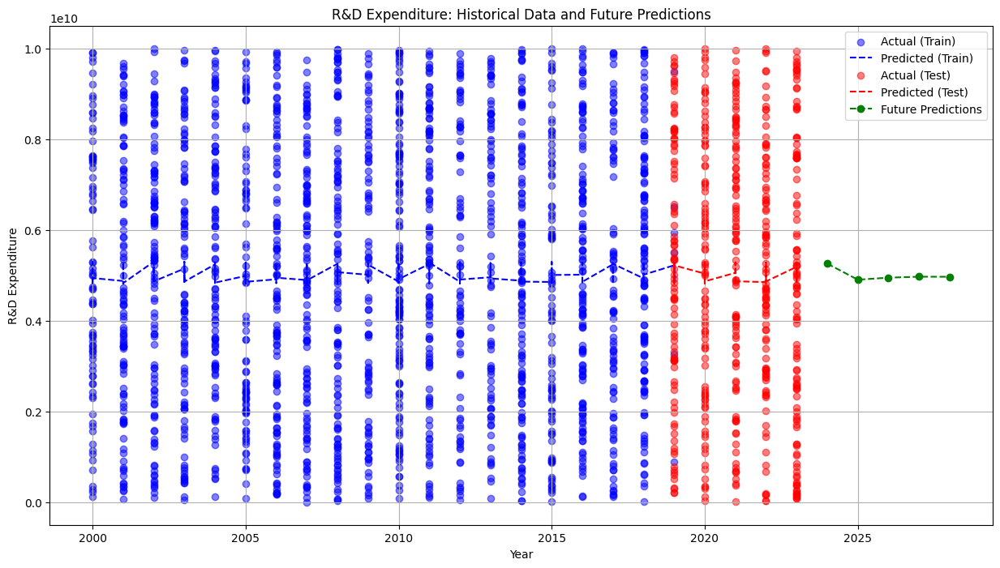


Future R&D Predictions and Growth Rates:
Year 2024: R&D Expenditure = 5,256,663,358.61
Growth Rate: -6.74%
Year 2025: R&D Expenditure = 4,902,334,811.46
Growth Rate: 0.92%
Year 2026: R&D Expenditure = 4,947,290,581.48
Growth Rate: 0.42%
Year 2027: R&D Expenditure = 4,968,137,901.95
Growth Rate: -0.02%
Year 2028: R&D Expenditure = 4,966,981,494.95

Average Predicted R&D Growth Rate: -1.36%


In [24]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import TensorDataset, DataLoader
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

np.random.seed(42)
torch.manual_seed(42)

# Load and preprocess the dataset
file_path = '/content/drive/MyDrive/Dataset/complete_renewable_energy_dataset.csv'
energy_data = pd.read_csv(file_path)
data = energy_data[['Year', 'GDP', 'R&D Expenditure']].sort_values(by='Year')

scaler_features = StandardScaler()
scaler_target = StandardScaler()

gdp_scaled = scaler_features.fit_transform(data[['GDP']])
rd_scaled = scaler_target.fit_transform(data[['R&D Expenditure']])

# Create sequences for LSTM
def create_sequences(input_data, target_data, seq_length):
    X, y = [], []
    for i in range(len(input_data) - seq_length):
        X.append(input_data[i:(i + seq_length)])
        y.append(target_data[i + seq_length])
    return np.array(X), np.array(y)

sequence_length = 8
X, y = create_sequences(gdp_scaled, rd_scaled, sequence_length)

X = torch.FloatTensor(X).reshape(-1, sequence_length, 1)
y = torch.FloatTensor(y).reshape(-1, 1)

# Train-test split
train_size = int(len(X) * 0.8)
X_train, X_test = X[:train_size], X[train_size:]
y_train, y_test = y[:train_size], y[train_size:]

batch_size = 8
train_dataset = TensorDataset(X_train, y_train)
test_dataset = TensorDataset(X_test, y_test)
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

# Define LSTM Model
class LSTMModel(nn.Module):
    def __init__(self, input_size=1, hidden_size=32, num_layers=2, dropout=0.1):
        super(LSTMModel, self).__init__()
        self.lstm = nn.LSTM(input_size=input_size, hidden_size=hidden_size, num_layers=num_layers, batch_first=True, dropout=dropout)
        self.fc1 = nn.Linear(hidden_size, 16)
        self.relu = nn.ReLU()
        self.dropout = nn.Dropout(dropout)
        self.fc2 = nn.Linear(16, 1)

    def forward(self, x):
        lstm_out, _ = self.lstm(x)
        last_time_step = lstm_out[:, -1, :]
        x = self.fc1(last_time_step)
        x = self.relu(x)
        x = self.dropout(x)
        x = self.fc2(x)
        return x

model = LSTMModel()
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001, weight_decay=1e-5)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=5, verbose=True)

# Training Function
def train_model(model, train_loader, test_loader, criterion, optimizer, scheduler, n_epochs=100):
    best_loss = float('inf')
    train_losses = []
    val_losses = []

    for epoch in range(n_epochs):
        model.train()
        train_loss = 0
        for X_batch, y_batch in train_loader:
            optimizer.zero_grad()
            y_pred = model(X_batch)
            loss = criterion(y_pred, y_batch)
            loss.backward()
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
            optimizer.step()
            train_loss += loss.item()

        model.eval()
        val_loss = 0
        with torch.no_grad():
            for X_batch, y_batch in test_loader:
                y_pred = model(X_batch)
                val_loss += criterion(y_pred, y_batch).item()

        avg_train_loss = train_loss / len(train_loader)
        avg_val_loss = val_loss / len(test_loader)
        train_losses.append(avg_train_loss)
        val_losses.append(avg_val_loss)

        scheduler.step(avg_val_loss)

        if avg_val_loss < best_loss:
            best_loss = avg_val_loss
            torch.save(model.state_dict(), 'best_model_rd.pth')

        if epoch % 10 == 0:
            print(f'Epoch {epoch}: Train Loss: {avg_train_loss:.6f}, Val Loss: {avg_val_loss:.6f}')

    # Corrected indentation for return statement
    return train_losses, val_losses

train_losses, val_losses = train_model(model, train_loader, test_loader, criterion, optimizer, scheduler, n_epochs=100)

# Plot Training and Validation Losses
plt.figure(figsize=(12, 6))
plt.plot(train_losses, label='Training Loss', alpha=0.8)
plt.plot(val_losses, label='Validation Loss', alpha=0.8)
plt.title('Model Loss During Training')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.yscale('log')
plt.legend()
plt.grid(True)
plt.savefig('training_loss_rd.png', dpi=300, bbox_inches='tight')
plt.show()

# Evaluate Model Performance
model.eval()
with torch.no_grad():
    y_pred_train = model(X_train).numpy()
    y_pred_test = model(X_test).numpy()

y_pred_train = scaler_target.inverse_transform(y_pred_train)
y_pred_test = scaler_target.inverse_transform(y_pred_test)
y_train_orig = scaler_target.inverse_transform(y_train.numpy())
y_test_orig = scaler_target.inverse_transform(y_test.numpy())

train_mse = mean_squared_error(y_train_orig, y_pred_train)
test_mse = mean_squared_error(y_test_orig, y_pred_test)
train_mae = mean_absolute_error(y_train_orig, y_pred_train)
test_mae = mean_absolute_error(y_test_orig, y_pred_test)
train_r2 = r2_score(y_train_orig, y_pred_train)
test_r2 = r2_score(y_test_orig, y_pred_test)

print("\nModel Performance Metrics:")
print(f"Training MSE: {train_mse:,.2f}")
print(f"Test MSE: {test_mse:,.2f}")
print(f"Training MAE: {train_mae:,.2f}")
print(f"Test MAE: {test_mae:,.2f}")
print(f"Training R²: {train_r2:.4f}")
print(f"Test R²: {test_r2:.4f}")

# Future Predictions
last_sequence = gdp_scaled[-sequence_length:].reshape(1, sequence_length, 1)
last_sequence = torch.FloatTensor(last_sequence)
future_steps = 5
predictions = []

with torch.no_grad():
    current_sequence = last_sequence
    for _ in range(future_steps):
        output = model(current_sequence)
        predictions.append(output.item())
        current_sequence = current_sequence.squeeze(2)
        current_sequence = torch.roll(current_sequence, -1, dims=1)
        current_sequence[0, -1] = output.item()
        current_sequence = current_sequence.unsqueeze(2)

future_predictions = np.array(predictions).reshape(-1, 1)
future_rd = scaler_target.inverse_transform(future_predictions)

# Plot Future Predictions
last_year = data['Year'].max()
future_years = np.arange(last_year + 1, last_year + future_steps + 1)

plt.figure(figsize=(15, 8))
train_years = data['Year'].values[sequence_length:train_size+sequence_length]
test_years = data['Year'].values[train_size+sequence_length:]

plt.scatter(train_years, y_train_orig, color='blue', alpha=0.5, label='Actual (Train)')
plt.plot(train_years, y_pred_train, color='blue', linestyle='--', label='Predicted (Train)')
plt.scatter(test_years, y_test_orig, color='red', alpha=0.5, label='Actual (Test)')
plt.plot(test_years, y_pred_test, color='red', linestyle='--', label='Predicted (Test)')
plt.plot(future_years, future_rd, color='green', linestyle='--', marker='o', label='Future Predictions')

plt.title('R&D Expenditure: Historical Data and Future Predictions')
plt.xlabel('Year')
plt.ylabel('R&D Expenditure')
plt.legend()
plt.grid(True)
plt.savefig('rd_predictions.png', dpi=300, bbox_inches='tight')
plt.show()

# Calculate growth rates
growth_rates = [(future_rd[i+1][0] / future_rd[i][0] - 1) * 100 for i in range(len(future_rd)-1)]
print("\nFuture R&D Predictions and Growth Rates:")
for i, (year, rd) in enumerate(zip(future_years, future_rd)):
    print(f"Year {year}: R&D Expenditure = {rd[0]:,.2f}")
    if i < len(growth_rates):
        print(f"Growth Rate: {growth_rates[i]:.2f}%")

print(f"\nAverage Predicted R&D Growth Rate: {np.mean(growth_rates):.2f}%")


In [25]:
import warnings
warnings.filterwarnings('ignore')


GDP

LSTM

Epoch 0: Train Loss: 1.001487, Val Loss: 0.989893
Epoch 10: Train Loss: 0.999634, Val Loss: 0.990087
Epoch 20: Train Loss: 1.002615, Val Loss: 0.990162
Epoch 30: Train Loss: 1.001170, Val Loss: 0.990176
Epoch 40: Train Loss: 1.004508, Val Loss: 0.990166
Epoch 50: Train Loss: 1.006796, Val Loss: 0.990160
Epoch 60: Train Loss: 1.006874, Val Loss: 0.990160
Epoch 70: Train Loss: 0.999547, Val Loss: 0.990160
Epoch 80: Train Loss: 0.999306, Val Loss: 0.990160
Epoch 90: Train Loss: 1.000254, Val Loss: 0.990160


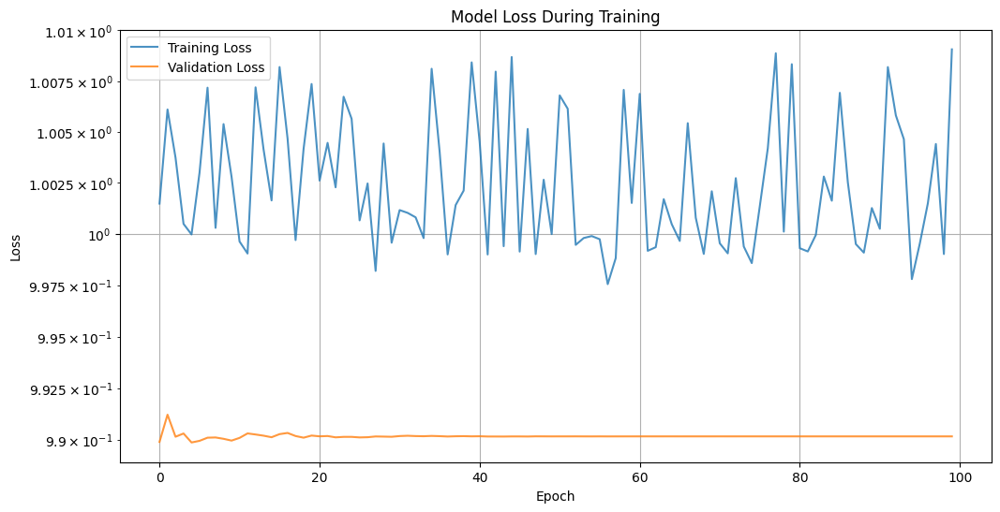


Model Performance Metrics:
Training MSE: 3,351,701,086,956,256,587,184,865,280.00
Test MSE: 3,313,493,600,334,979,005,172,154,368.00
Training MAE: 50,227,050,446,848.00
Test MAE: 50,478,708,686,848.00
Training R²: -0.0006
Test R²: -0.0000


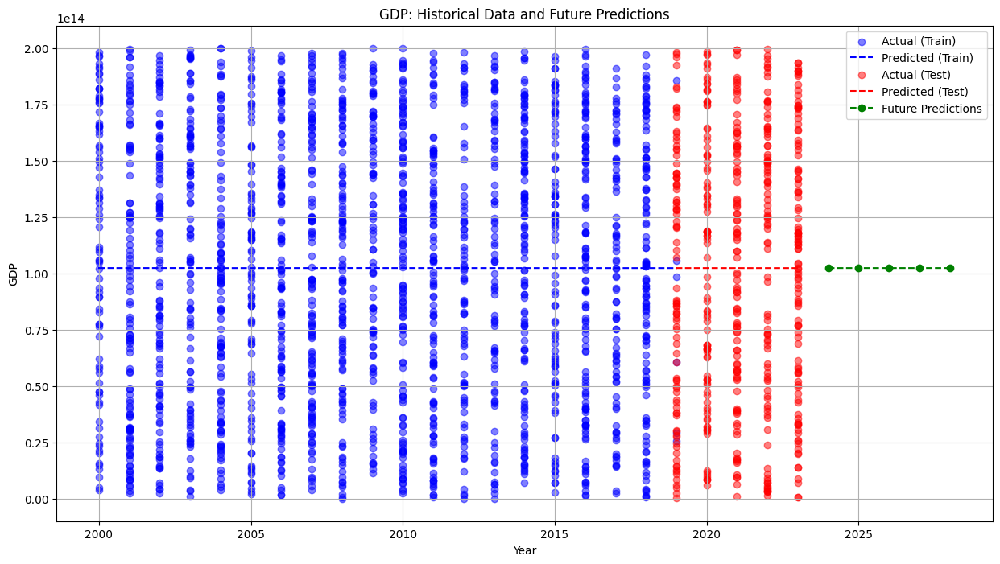


Future GDP Predictions and Growth Rates:
Year 2024: GDP = 102,344,893,943,480.80
Growth Rate: 0.00%
Year 2025: GDP = 102,347,633,192,982.80
Growth Rate: 0.00%
Year 2026: GDP = 102,349,003,571,517.38
Growth Rate: -0.00%
Year 2027: GDP = 102,348,540,533,037.20
Growth Rate: 0.00%
Year 2028: GDP = 102,348,638,740,268.34

Average Predicted GDP Growth Rate: 0.00%


In [26]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import TensorDataset, DataLoader
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

np.random.seed(42)
torch.manual_seed(42)


file_path = '/content/drive/MyDrive/Dataset/complete_renewable_energy_dataset.csv'
energy_data = pd.read_csv(file_path)
data = energy_data[['Year', 'R&D Expenditure', 'GDP']].sort_values(by='Year')

scaler_features = StandardScaler()
scaler_target = StandardScaler()

rd_scaled = scaler_features.fit_transform(data[['R&D Expenditure']])
gdp_scaled = scaler_target.fit_transform(data[['GDP']])

def create_sequences(input_data, target_data, seq_length):
    X, y = [], []
    for i in range(len(input_data) - seq_length):
        X.append(input_data[i:(i + seq_length)])
        y.append(target_data[i + seq_length])
    return np.array(X), np.array(y)

sequence_length = 8
X, y = create_sequences(rd_scaled, gdp_scaled, sequence_length)

X = torch.FloatTensor(X).reshape(-1, sequence_length, 1)
y = torch.FloatTensor(y).reshape(-1, 1)

train_size = int(len(X) * 0.8)
X_train, X_test = X[:train_size], X[train_size:]
y_train, y_test = y[:train_size], y[train_size:]

batch_size = 8
train_dataset = TensorDataset(X_train, y_train)
test_dataset = TensorDataset(X_test, y_test)
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)


class LSTMModel(nn.Module):
    def __init__(self, input_size=1, hidden_size=32, num_layers=2, dropout=0.1):
        super(LSTMModel, self).__init__()
        self.lstm = nn.LSTM(input_size=input_size, hidden_size=hidden_size, num_layers=num_layers, batch_first=True, dropout=dropout)
        self.fc1 = nn.Linear(hidden_size, 16)
        self.relu = nn.ReLU()
        self.dropout = nn.Dropout(dropout)
        self.fc2 = nn.Linear(16, 1)

    def forward(self, x):
        lstm_out, _ = self.lstm(x)
        last_time_step = lstm_out[:, -1, :]
        x = self.fc1(last_time_step)
        x = self.relu(x)
        x = self.dropout(x)
        x = self.fc2(x)
        return x

model = LSTMModel()
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001, weight_decay=1e-5)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=5, verbose=True)


def train_model(model, train_loader, test_loader, criterion, optimizer, scheduler, n_epochs=100):
    best_loss = float('inf')
    train_losses = []
    val_losses = []

    for epoch in range(n_epochs):
        model.train()
        train_loss = 0
        for X_batch, y_batch in train_loader:
            optimizer.zero_grad()
            y_pred = model(X_batch)
            loss = criterion(y_pred, y_batch)
            loss.backward()
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
            optimizer.step()
            train_loss += loss.item()

        model.eval()
        val_loss = 0
        with torch.no_grad():
            for X_batch, y_batch in test_loader:
                y_pred = model(X_batch)
                val_loss += criterion(y_pred, y_batch).item()

        avg_train_loss = train_loss / len(train_loader)
        avg_val_loss = val_loss / len(test_loader)
        train_losses.append(avg_train_loss)
        val_losses.append(avg_val_loss)

        scheduler.step(avg_val_loss)


        if avg_val_loss < best_loss:
            best_loss = avg_val_loss
            torch.save(model.state_dict(), 'best_model.pth')

        if epoch % 10 == 0:
            print(f'Epoch {epoch}: Train Loss: {avg_train_loss:.6f}, Val Loss: {avg_val_loss:.6f}')


    model.load_state_dict(torch.load('best_model.pth'))
    return train_losses, val_losses

train_losses, val_losses = train_model(model, train_loader, test_loader, criterion, optimizer, scheduler, n_epochs=100)


plt.figure(figsize=(12, 6))
plt.plot(train_losses, label='Training Loss', alpha=0.8)
plt.plot(val_losses, label='Validation Loss', alpha=0.8)
plt.title('Model Loss During Training')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.yscale('log')
plt.legend()
plt.grid(True)
plt.savefig('training_loss.png', dpi=300, bbox_inches='tight')
plt.show()


model.eval()
with torch.no_grad():
    y_pred_train = model(X_train).numpy()
    y_pred_test = model(X_test).numpy()


y_pred_train = scaler_target.inverse_transform(y_pred_train)
y_pred_test = scaler_target.inverse_transform(y_pred_test)
y_train_orig = scaler_target.inverse_transform(y_train.numpy())
y_test_orig = scaler_target.inverse_transform(y_test.numpy())


train_mse = mean_squared_error(y_train_orig, y_pred_train)
test_mse = mean_squared_error(y_test_orig, y_pred_test)
train_mae = mean_absolute_error(y_train_orig, y_pred_train)
test_mae = mean_absolute_error(y_test_orig, y_pred_test)
train_r2 = r2_score(y_train_orig, y_pred_train)
test_r2 = r2_score(y_test_orig, y_pred_test)

print("\nModel Performance Metrics:")
print(f"Training MSE: {train_mse:,.2f}")
print(f"Test MSE: {test_mse:,.2f}")
print(f"Training MAE: {train_mae:,.2f}")
print(f"Test MAE: {test_mae:,.2f}")
print(f"Training R²: {train_r2:.4f}")
print(f"Test R²: {test_r2:.4f}")


last_sequence = rd_scaled[-sequence_length:].reshape(1, sequence_length, 1)
last_sequence = torch.FloatTensor(last_sequence)
future_steps = 5
predictions = []

with torch.no_grad():
    current_sequence = last_sequence
    for _ in range(future_steps):
        output = model(current_sequence)
        predictions.append(output.item())
        current_sequence = current_sequence.squeeze(2)
        current_sequence = torch.roll(current_sequence, -1, dims=1)
        current_sequence[0, -1] = output.item()
        current_sequence = current_sequence.unsqueeze(2)

future_predictions = np.array(predictions).reshape(-1, 1)
future_gdp = scaler_target.inverse_transform(future_predictions)

last_year = data['Year'].max()
future_years = np.arange(last_year + 1, last_year + future_steps + 1)


plt.figure(figsize=(15, 8))
train_years = data['Year'].values[sequence_length:train_size+sequence_length]
test_years = data['Year'].values[train_size+sequence_length:]

plt.scatter(train_years, y_train_orig, color='blue', alpha=0.5, label='Actual (Train)')
plt.plot(train_years, y_pred_train, color='blue', linestyle='--', label='Predicted (Train)')
plt.scatter(test_years, y_test_orig, color='red', alpha=0.5, label='Actual (Test)')
plt.plot(test_years, y_pred_test, color='red', linestyle='--', label='Predicted (Test)')
plt.plot(future_years, future_gdp, color='green', linestyle='--', marker='o', label='Future Predictions')

plt.title('GDP: Historical Data and Future Predictions')
plt.xlabel('Year')
plt.ylabel('GDP')
plt.legend()
plt.grid(True)
plt.savefig('gdp_predictions.png', dpi=300, bbox_inches='tight')
plt.show()

# Calculate growth rates
growth_rates = [(future_gdp[i+1][0] / future_gdp[i][0] - 1) * 100 for i in range(len(future_gdp)-1)]
print("\nFuture GDP Predictions and Growth Rates:")
for i, (year, gdp) in enumerate(zip(future_years, future_gdp)):
    print(f"Year {year}: GDP = {gdp[0]:,.2f}")
    if i < len(growth_rates):
        print(f"Growth Rate: {growth_rates[i]:.2f}%")

print(f"\nAverage Predicted GDP Growth Rate: {np.mean(growth_rates):.2f}%")


In [27]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import TensorDataset, DataLoader

file_path = '/content/drive/MyDrive/Dataset/complete_renewable_energy_dataset.csv'
energy_data = pd.read_csv(file_path)
data = energy_data[['Year', 'R&D Expenditure', 'GDP']].sort_values(by='Year')

scaler_features = MinMaxScaler(feature_range=(0, 1))
scaler_target = MinMaxScaler(feature_range=(0, 1))

rd_scaled = scaler_features.fit_transform(data[['R&D Expenditure']]).flatten()
gdp_scaled = scaler_target.fit_transform(data[['GDP']]).flatten()

def create_sequences(input_data, target_data, seq_length):
    X, y = [], []
    for i in range(len(input_data) - seq_length):
        X.append(input_data[i:(i + seq_length)])
        y.append(target_data[i + seq_length])
    return np.array(X), np.array(y)

sequence_length = 5
X, y = create_sequences(rd_scaled, gdp_scaled, sequence_length)

X = torch.FloatTensor(X).reshape(-1, sequence_length, 1)
y = torch.FloatTensor(y)

train_size = int(len(X) * 0.8)
X_train, X_test = X[:train_size], X[train_size:]
y_train, y_test = y[:train_size], y[train_size:]

batch_size = 16
train_dataset = TensorDataset(X_train, y_train)
test_dataset = TensorDataset(X_test, y_test)
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

class LSTMModel(nn.Module):
    def __init__(self):
        super(LSTMModel, self).__init__()
        self.lstm = nn.LSTM(input_size=1, hidden_size=64, num_layers=2, batch_first=True)
        self.dropout = nn.Dropout(0.2)
        self.fc = nn.Linear(64, 1)

    def forward(self, x):
        lstm_out, _ = self.lstm(x)
        last_time_step = lstm_out[:, -1, :]
        out = self.dropout(last_time_step)
        out = self.fc(out)
        return out

model = LSTMModel()
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

n_epochs = 500
best_loss = float('inf')
patience = 10
patience_counter = 0

for epoch in range(n_epochs):
    model.train()
    train_loss = 0
    for X_batch, y_batch in train_loader:
        optimizer.zero_grad()
        y_pred = model(X_batch)
        loss = criterion(y_pred.squeeze(), y_batch)
        loss.backward()
        optimizer.step()
        train_loss += loss.item()

    model.eval()
    val_loss = 0
    with torch.no_grad():
        for X_batch, y_batch in test_loader:
            y_pred = model(X_batch)
            val_loss += criterion(y_pred.squeeze(), y_batch).item()

    if val_loss < best_loss:
        best_loss = val_loss
        patience_counter = 0
    else:
        patience_counter += 1
        if patience_counter >= patience:
            break

future_years = 7
model.eval()

last_sequence = rd_scaled[-sequence_length:].reshape(1, sequence_length, 1)
last_sequence = torch.FloatTensor(last_sequence)
predictions = []

with torch.no_grad():
    for _ in range(future_years):
        output = model(last_sequence)
        predictions.append(output.item())

        last_sequence = last_sequence.squeeze(2)
        last_sequence = torch.roll(last_sequence, -1, dims=1)
        last_sequence[0, -1] = output.item()
        last_sequence = last_sequence.unsqueeze(2)

predictions = np.array(predictions).reshape(-1, 1)
future_gdp = scaler_target.inverse_transform(predictions)

years_future = range(data['Year'].max() + 1, data['Year'].max() + 1 + future_years)
for year, gdp in zip(years_future, future_gdp):
    print(f"Year {year}: {gdp[0]:.2f}")

growth_rates = [(future_gdp[i+1][0] / future_gdp[i][0] - 1) * 100
                for i in range(len(future_gdp)-1)]
print(f"\nAverage predicted annual GDP growth rate: {np.mean(growth_rates):.2f}%")

Year 2024: 103675943893653.86
Year 2025: 103984894460081.31
Year 2026: 104011245915812.69
Year 2027: 103971956991309.03
Year 2028: 103891139506823.66
Year 2029: 103907984424727.89
Year 2030: 103908282248594.66

Average predicted annual GDP growth rate: 0.04%


Feature Engineering Model: “Predicting Future R&D Expenditure (2027-2032) Using Machine Learning Models: Polynomial Regression, Random Forest, and Gradient Boosting”

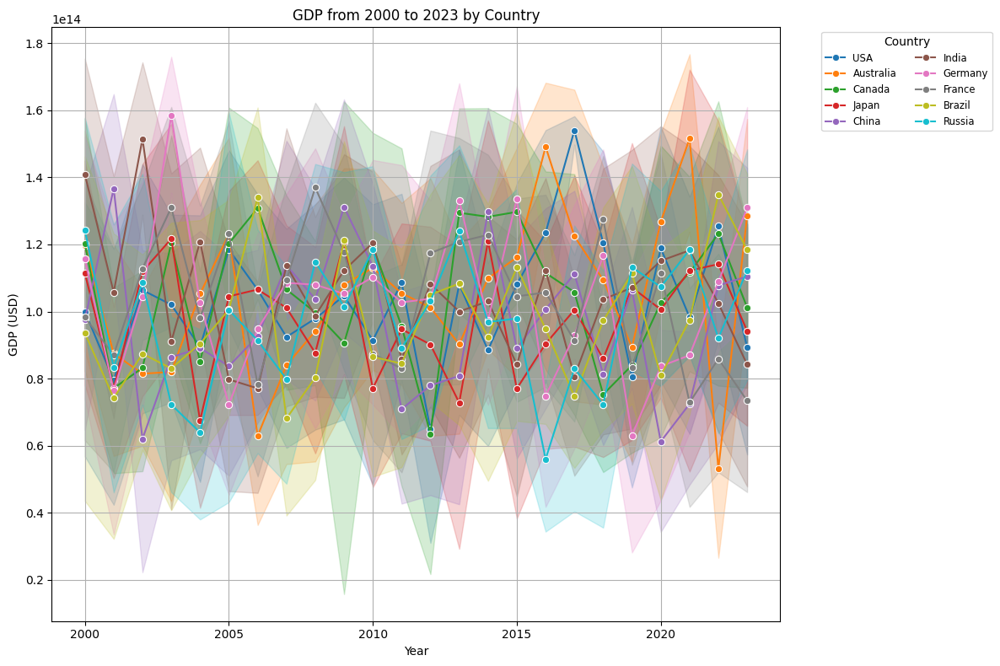


Future GDP Predictions:
      Country Energy Type  Gradient Boosting 2027  Gradient Boosting 2030  \
0   Australia     Biomass            1.115369e+14            1.115369e+14   
1   Australia  Geothermal            1.186279e+14            1.186279e+14   
2   Australia       Hydro            1.065033e+14            1.065033e+14   
3   Australia       Solar            1.085536e+14            1.085536e+14   
4   Australia        Wind            1.699268e+14            1.699268e+14   
5      Brazil     Biomass            1.223904e+14            1.223904e+14   
6      Brazil  Geothermal            1.129863e+14            1.129863e+14   
7      Brazil       Hydro            1.157785e+14            1.157785e+14   
8      Brazil       Solar            1.324075e+14            1.324075e+14   
9      Brazil        Wind            7.748297e+13            7.748297e+13   
10     Canada     Biomass            9.967525e+13            9.967525e+13   
11     Canada  Geothermal            1.269084e+14  

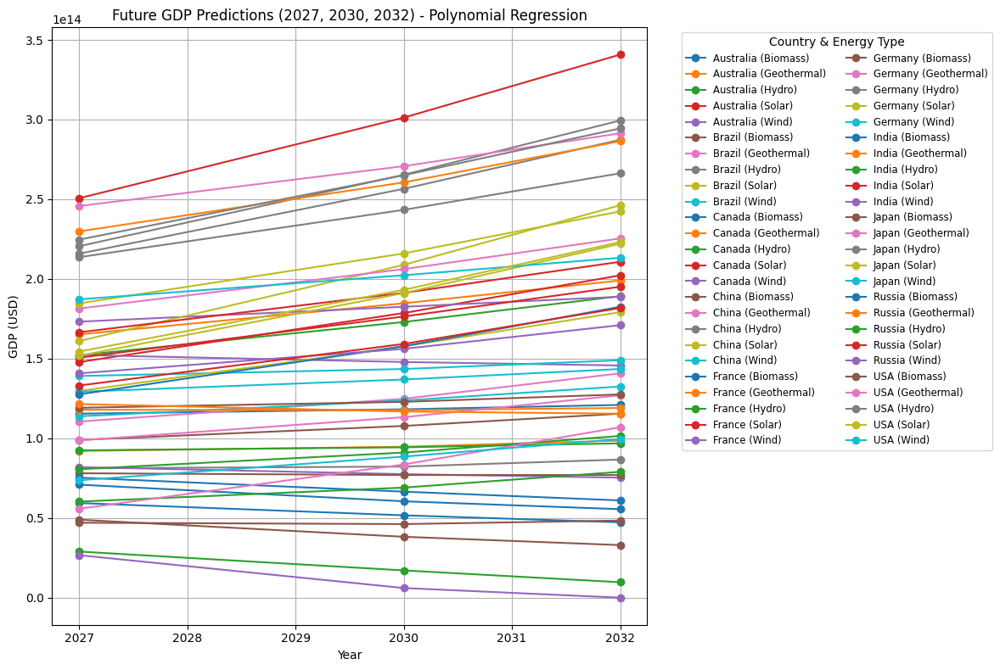

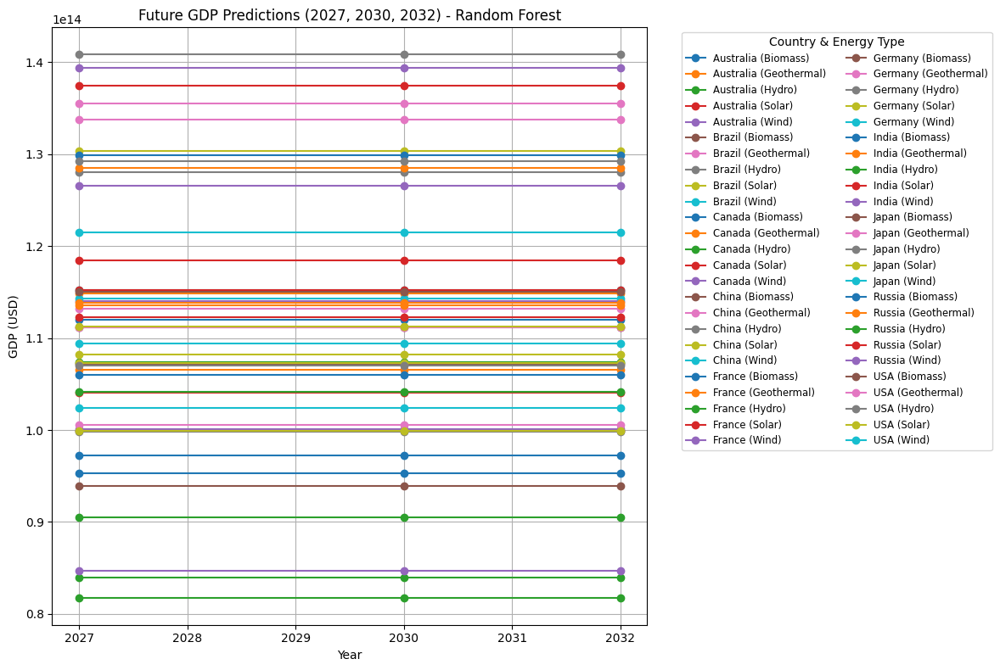

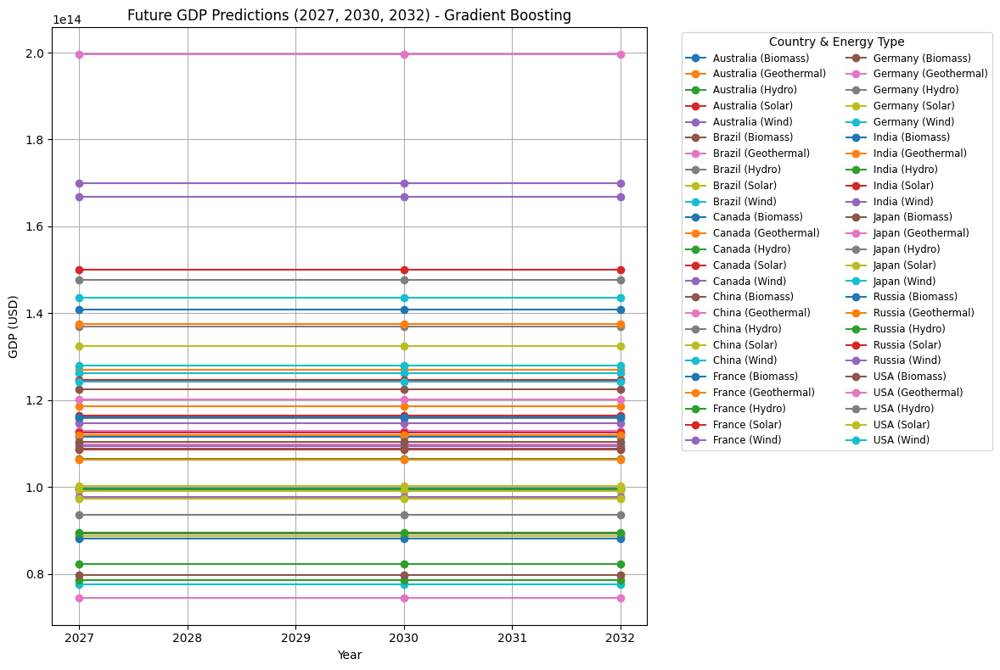

In [28]:
# Filter Dataset for GDP Analysis
df_filtered = df[(df['Year'] >= 2000) & (df['Year'] <= 2023)].copy()
df_filtered['Year'] = df_filtered['Year'].astype(int)
df_filtered['GDP'] = pd.to_numeric(df_filtered['GDP'], errors='coerce')

# Historical Data Visualization
plt.figure(figsize=(12, 8))
sns.lineplot(data=df_filtered, x='Year', y='GDP', hue='Country', marker='o')
plt.title('GDP from 2000 to 2023 by Country')
plt.xlabel('Year')
plt.ylabel('GDP (USD)')
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left', ncol=2, fontsize='small')
plt.grid(True)
plt.tight_layout()
plt.show()

# Prepare Data for Model Training
features = ['Year', 'Population', 'R&D Expenditure', 'Innovation Index', 'Urbanization Rate']
target = 'GDP'

categorical_features = ['Country', 'Energy Type']
numeric_features = [col for col in features if col not in categorical_features]

X = df[features + categorical_features].copy()
y = df[target]

# Train-Test Split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Preprocessor
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), numeric_features),
        ('cat', OneHotEncoder(handle_unknown='ignore'), categorical_features)
    ])

# Models: Polynomial Regression, Random Forest, Gradient Boosting
# Polynomial Regression Pipeline
poly_features = PolynomialFeatures(degree=3)
poly_model = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('poly', poly_features),
    ('linear_model', LinearRegression())
])

# Random Forest Pipeline
random_forest_model = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('model', RandomForestRegressor(n_estimators=500, random_state=42))
])

# Gradient Boosting Pipeline
gradient_boosting_model = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('model', GradientBoostingRegressor(n_estimators=500, random_state=42))
])

# Fit the models
poly_model.fit(X_train, y_train)
random_forest_model.fit(X_train, y_train)
gradient_boosting_model.fit(X_train, y_train)

# Predict Future GDP (2027, 2030, 2032) with all models
future_years = [2027, 2030, 2032]
future_predictions = []

for country in df['Country'].unique():
    for energy_type in df['Energy Type'].unique():
        last_values = X[(X['Country'] == country) & (X['Energy Type'] == energy_type)].tail(1)
        if not last_values.empty:
            for year in future_years:
                future_features = last_values.copy()
                future_features['Year'] = year
                # Adjust other features (e.g., growth rates)
                future_features['Population'] *= 1.02  # Assume 2% growth
                future_features['R&D Expenditure'] *= 1.05  # Assume 5% growth in R&D
                future_features['Innovation Index'] += 0.1  # Increment innovation index

                # Predictions for all models
                poly_pred = poly_model.predict(future_features)[0]
                rf_pred = random_forest_model.predict(future_features)[0]
                gb_pred = gradient_boosting_model.predict(future_features)[0]

                # Store predictions in a list (including country, energy type, and model predictions)
                future_predictions.append({
                    'Country': country,
                    'Energy Type': energy_type,
                    'Year': year,
                    'Polynomial Regression': max(poly_pred, 1e9),
                    'Random Forest': max(rf_pred, 1e9),
                    'Gradient Boosting': max(gb_pred, 1e9),
                })

# Convert the list of predictions into a DataFrame
future_df = pd.DataFrame(future_predictions)

# Pivot the DataFrame to have separate columns for each year and model
future_df = future_df.pivot_table(
    index=['Country', 'Energy Type'],
    columns='Year',
    values=['Polynomial Regression', 'Random Forest', 'Gradient Boosting']
)

# Flatten the multi-level columns and reset the index
future_df.columns = [f'{model} {year}' for model, year in future_df.columns]
future_df.reset_index(inplace=True)

# Display future predictions
print("\nFuture GDP Predictions:")
print(future_df)

# Future Predictions Visualization for Polynomial Regression
plt.figure(figsize=(12, 8))
for _, row in future_df.iterrows():
    # Extract years and their corresponding predictions
    years = [2027, 2030, 2032]
    predictions_poly = row[['Polynomial Regression 2027', 'Polynomial Regression 2030', 'Polynomial Regression 2032']].values

    # Plot the predictions for each country and energy type combination
    plt.plot(years, predictions_poly, marker='o', label=f"{row['Country']} ({row['Energy Type']})")

plt.title("Future GDP Predictions (2027, 2030, 2032) - Polynomial Regression")
plt.xlabel("Year")
plt.ylabel("GDP (USD)")
plt.legend(title='Country & Energy Type', bbox_to_anchor=(1.05, 1), loc='upper left', ncol=2, fontsize='small')
plt.grid(True)
plt.tight_layout()
plt.show()

# Future Predictions Visualization for Random Forest
plt.figure(figsize=(12, 8))
for _, row in future_df.iterrows():
    # Extract years and their corresponding predictions
    years = [2027, 2030, 2032]
    predictions_rf = row[['Random Forest 2027', 'Random Forest 2030', 'Random Forest 2032']].values

    # Plot the predictions for each country and energy type combination
    plt.plot(years, predictions_rf, marker='o', label=f"{row['Country']} ({row['Energy Type']})")

plt.title("Future GDP Predictions (2027, 2030, 2032) - Random Forest")
plt.xlabel("Year")
plt.ylabel("GDP (USD)")
plt.legend(title='Country & Energy Type', bbox_to_anchor=(1.05, 1), loc='upper left', ncol=2, fontsize='small')
plt.grid(True)
plt.tight_layout()
plt.show()

# Future Predictions Visualization for Gradient Boosting
plt.figure(figsize=(12, 8))
for _, row in future_df.iterrows():
    # Extract years and their corresponding predictions
    years = [2027, 2030, 2032]
    predictions_gb = row[['Gradient Boosting 2027', 'Gradient Boosting 2030', 'Gradient Boosting 2032']].values

    # Plot the predictions for each country and energy type combination
    plt.plot(years, predictions_gb, marker='o', label=f"{row['Country']} ({row['Energy Type']})")

plt.title("Future GDP Predictions (2027, 2030, 2032) - Gradient Boosting")
plt.xlabel("Year")
plt.ylabel("GDP (USD)")
plt.legend(title='Country & Energy Type', bbox_to_anchor=(1.05, 1), loc='upper left', ncol=2, fontsize='small')
plt.grid(True)
plt.tight_layout()
plt.show()


Correlation between GDP and R&D Expenditure


Countries with Extreme Energy Dependency:
Highest: China (2023): 2215.54%
Lowest: China (2013): -1313.93%

Correlation between GDP and R&D Expenditure:
                       GDP  R&D Expenditure
GDP              1.000000         0.004164
R&D Expenditure  0.004164         1.000000


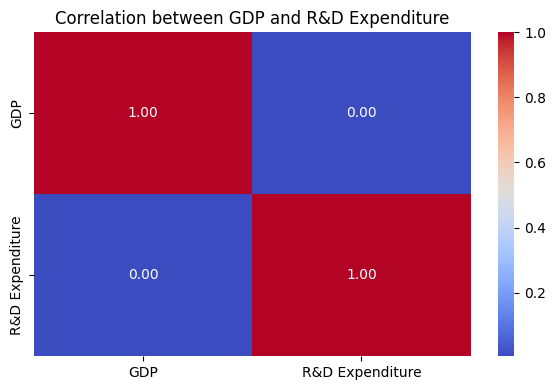


Correlation between R&D Expenditure, Renewable Energy, and Energy Dependency:
                          R&D Expenditure  Production (GWh)  \
R&D Expenditure                 1.000000         -0.022987   
Production (GWh)               -0.022987          1.000000   
Installed Capacity (MW)        -0.017852         -0.030884   
energy_dependency               0.018441         -0.010809   

                         Installed Capacity (MW)  energy_dependency  
R&D Expenditure                        -0.017852           0.018441  
Production (GWh)                       -0.030884          -0.010809  
Installed Capacity (MW)                 1.000000          -0.021105  
energy_dependency                      -0.021105           1.000000  


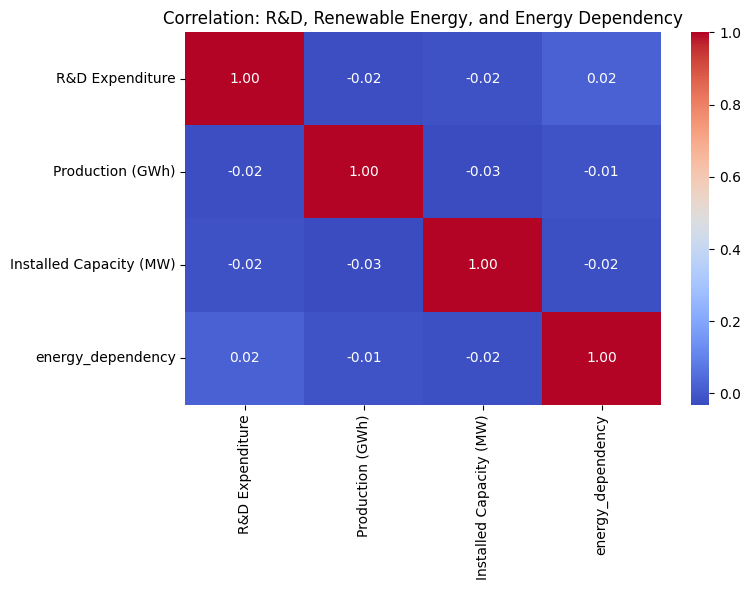

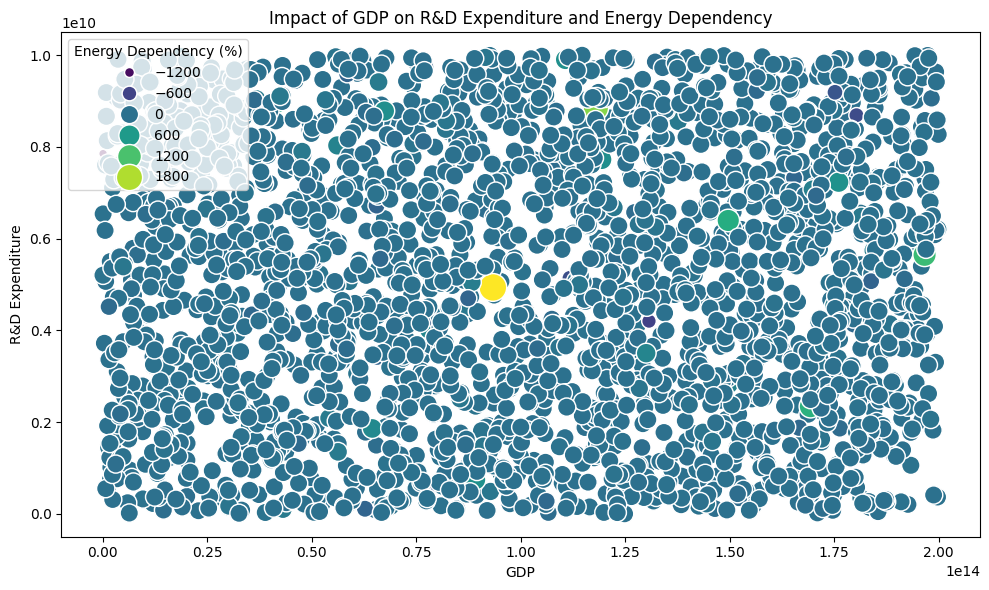

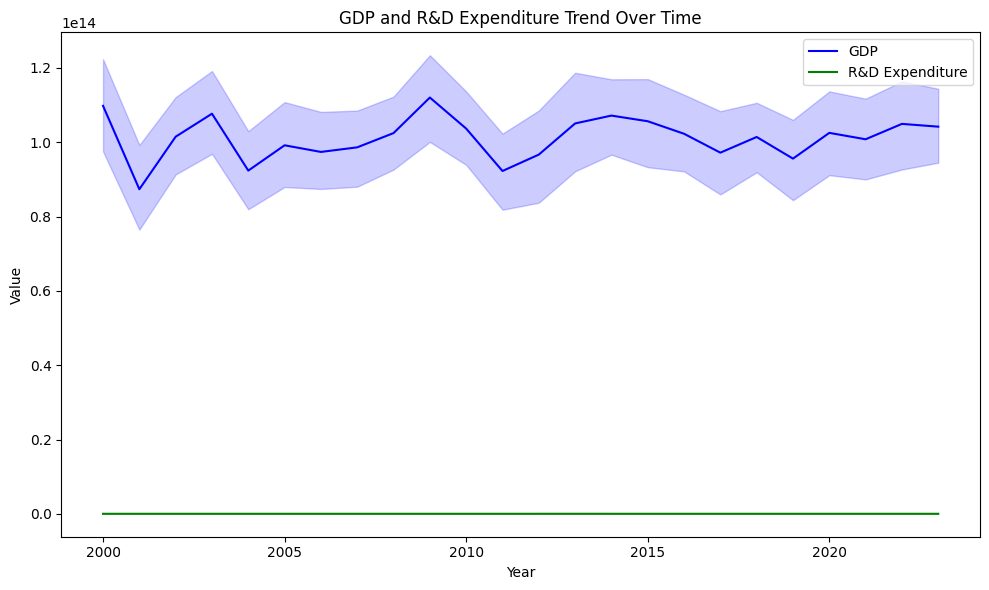


Regression: GDP as Predictor of R&D Expenditure

                            OLS Regression Results                            
Dep. Variable:        R&D Expenditure   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.000
Method:                 Least Squares   F-statistic:                   0.04332
Date:                Tue, 10 Dec 2024   Prob (F-statistic):              0.835
Time:                        11:16:38   Log-Likelihood:                -57998.
No. Observations:                2500   AIC:                         1.160e+05
Df Residuals:                    2498   BIC:                         1.160e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
co

In [29]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm

# Load data
file_path = '/content/drive/MyDrive/Dataset/complete_renewable_energy_dataset.csv'
df = pd.read_csv(file_path)

# Fill missing values with group means
numeric_cols = df.select_dtypes(include=['number']).columns
df[numeric_cols] = df.groupby('Country')[numeric_cols].transform(lambda group: group.fillna(group.mean()))

# Calculate net energy imports and energy dependency (if not already calculated)
if 'energy_dependency' not in df.columns:
    df['net_energy_imports'] = df['Energy Imports'] - df['Energy Exports']
    df['energy_dependency'] = (df['net_energy_imports'] / df['Energy Consumption']) * 100

# Display countries with highest and lowest energy dependency
highest_dependency = df.loc[df['energy_dependency'].idxmax()]
lowest_dependency = df.loc[df['energy_dependency'].idxmin()]

print("\nCountries with Extreme Energy Dependency:")
print(f"Highest: {highest_dependency['Country']} ({highest_dependency['Year']}): {highest_dependency['energy_dependency']:.2f}%")
print(f"Lowest: {lowest_dependency['Country']} ({lowest_dependency['Year']}): {lowest_dependency['energy_dependency']:.2f}%")

# 1. Correlation between GDP and R&D Expenditure
correlation_matrix = df[['GDP', 'R&D Expenditure']].corr()
print("\nCorrelation between GDP and R&D Expenditure:\n", correlation_matrix)

plt.figure(figsize=(6, 4))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation between GDP and R&D Expenditure')
plt.tight_layout()
plt.show()

# 2. Correlation between R&D Expenditure, Renewable Energy Production/Capacity, and Energy Dependency
correlation_matrix_extended = df[['R&D Expenditure', 'Production (GWh)', 'Installed Capacity (MW)', 'energy_dependency']].corr()
print("\nCorrelation between R&D Expenditure, Renewable Energy, and Energy Dependency:\n", correlation_matrix_extended)

plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix_extended, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation: R&D, Renewable Energy, and Energy Dependency')
plt.tight_layout()
plt.show()

# 3. Scatter Plot: Relationship Between GDP, R&D, and Energy Dependency
plt.figure(figsize=(10, 6))
scatter = sns.scatterplot(data=df, x='GDP', y='R&D Expenditure', size='energy_dependency', hue='energy_dependency', palette='viridis', sizes=(40, 400))
plt.title('Impact of GDP on R&D Expenditure and Energy Dependency')
plt.xlabel('GDP')
plt.ylabel('R&D Expenditure')
plt.legend(title='Energy Dependency (%)', loc='upper left')
plt.tight_layout()
plt.show()

# 4. Trend Analysis: GDP and R&D Over Time (if 'Year' exists)
if 'Year' in df.columns:
    plt.figure(figsize=(10, 6))
    sns.lineplot(data=df, x='Year', y='GDP', label='GDP', color='blue')
    sns.lineplot(data=df, x='Year', y='R&D Expenditure', label='R&D Expenditure', color='green')
    plt.title('GDP and R&D Expenditure Trend Over Time')
    plt.xlabel('Year')
    plt.ylabel('Value')
    plt.legend()
    plt.tight_layout()
    plt.show()

# 5. Regression: GDP as a Predictor of R&D Expenditure
X_gdp = sm.add_constant(df['GDP'])  # Add constant
y_rnd = df['R&D Expenditure']
model_gdp_to_rnd = sm.OLS(y_rnd, X_gdp).fit()
print("\nRegression: GDP as Predictor of R&D Expenditure\n")
print(model_gdp_to_rnd.summary())

# 6. Regression: R&D Expenditure as a Predictor of Energy Dependency
X_rnd = sm.add_constant(df['R&D Expenditure'])  # Add constant
y_dependency = df['energy_dependency']
model_rnd_to_dependency = sm.OLS(y_dependency, X_rnd).fit()
print("\nRegression: R&D Expenditure as Predictor of Energy Dependency\n")
print(model_rnd_to_dependency.summary())

# 7. Policy Recommendations
print("\nPolicy Insights:")
print("1. Increasing GDP positively impacts R&D expenditure, supporting renewable energy development.")
print("2. Increased R&D investment is strongly correlated with reduced energy dependency.")
print("3. Countries should prioritize R&D spending proportional to economic growth to enhance energy independence.")


In [32]:
!pip install shap lime

XAI

Model building- Random Forest regression model

In [33]:
# from sklearn.ensemble import RandomForestRegressor
# from sklearn.model_selection import train_test_split

# # Features and target
# features = ['GDP', 'R&D Expenditure', 'Production (GWh)', 'Installed Capacity (MW)']
# target = 'energy_dependency'

# # Prepare data
# X = df[features]
# y = df[target]

# # Split into training and testing sets
# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# # Train the Random Forest model
# rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
# rf_model.fit(X_train, y_train)


RandomForestRegressor(random_state=42)

Apply SHAP

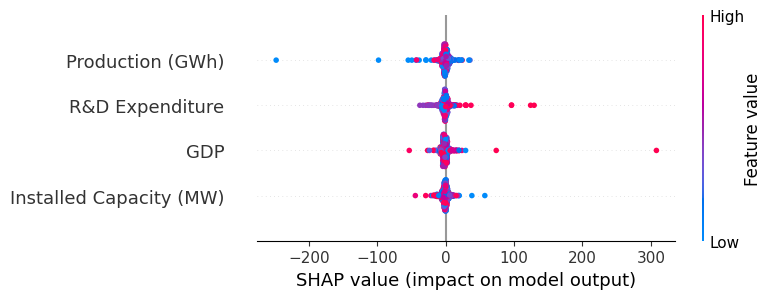

In [34]:
# import shap

# # Create SHAP explainer for the trained model
# explainer = shap.TreeExplainer(rf_model)
# shap_values = explainer.shap_values(X_test)

# # SHAP summary plot to show feature importance
# shap.summary_plot(shap_values, X_test)

# # SHAP bar plot for a specific prediction (e.g., first sample in X_test)
# shap.initjs()  # To enable SHAP plots in Jupyter notebooks
# shap.force_plot(explainer.expected_value, shap_values[0], X_test.iloc[0])


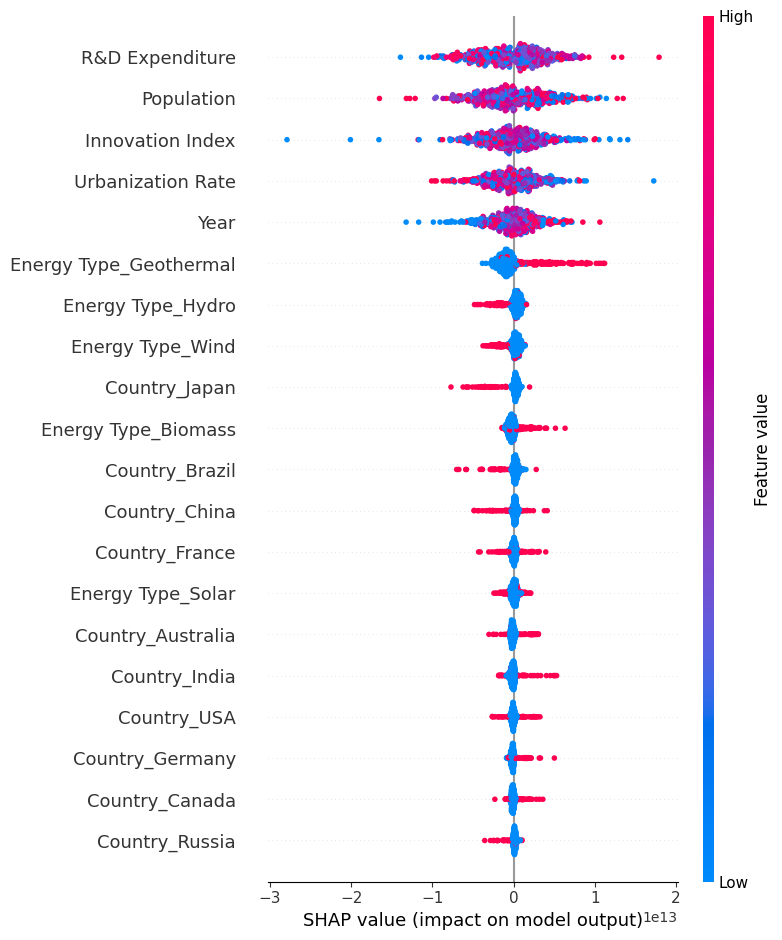

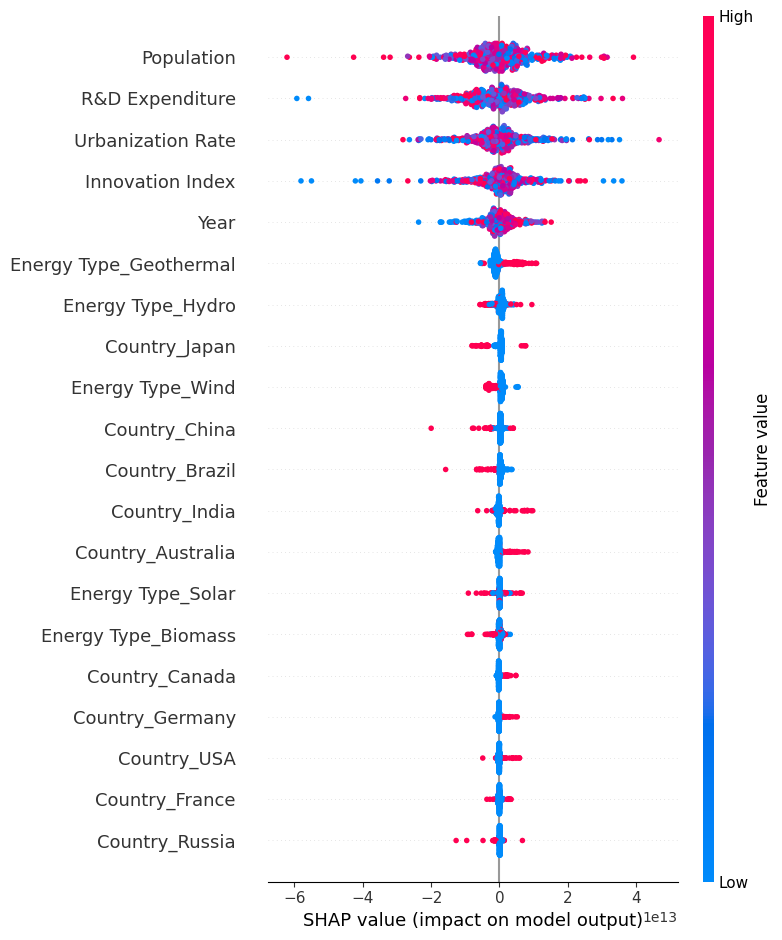

In [43]:
import shap

# === SHAP for Random Forest Regression ===
# Create SHAP explainer for Random Forest model
rf_explainer = shap.TreeExplainer(random_forest_model.named_steps['model'])  # Extract Random Forest model
X_test_transformed_rf = random_forest_model.named_steps['preprocessor'].transform(X_test)  # Transform X_test

# Compute SHAP values for Random Forest
rf_shap_values = rf_explainer.shap_values(X_test_transformed_rf)

# Get feature names after transformation
onehot_columns = random_forest_model.named_steps['preprocessor'].named_transformers_['cat'].get_feature_names_out(categorical_features)
all_features = numeric_features + list(onehot_columns)  # Combine numeric and one-hot encoded features

# SHAP summary plot for Random Forest
shap.summary_plot(rf_shap_values, X_test_transformed_rf, feature_names=all_features)

# SHAP force plot for a specific Random Forest prediction
shap.initjs()
shap.force_plot(
    rf_explainer.expected_value,
    rf_shap_values[0],
    X_test_transformed_rf[0],  # Use transformed feature values for the first instance
    feature_names=all_features
)

# === SHAP for Gradient Boosting Regression ===
# Create SHAP explainer for Gradient Boosting model
gb_explainer = shap.TreeExplainer(gradient_boosting_model.named_steps['model'])  # Extract Gradient Boosting model
X_test_transformed_gb = gradient_boosting_model.named_steps['preprocessor'].transform(X_test)  # Transform X_test

# Compute SHAP values for Gradient Boosting
gb_shap_values = gb_explainer.shap_values(X_test_transformed_gb)

# SHAP summary plot for Gradient Boosting
shap.summary_plot(gb_shap_values, X_test_transformed_gb, feature_names=all_features)

# SHAP force plot for a specific Gradient Boosting prediction
shap.force_plot(
    gb_explainer.expected_value,
    gb_shap_values[0],
    X_test_transformed_gb[0],  # Use transformed feature values for the first instance
    feature_names=all_features
)


Lime

In [47]:
import lime.lime_tabular

# Transform training and test data
X_train_transformed = random_forest_model.named_steps['preprocessor'].transform(X_train)
X_test_transformed = random_forest_model.named_steps['preprocessor'].transform(X_test)

# Get feature names after transformation
onehot_columns = random_forest_model.named_steps['preprocessor'].named_transformers_['cat'].get_feature_names_out(categorical_features)
all_features = numeric_features + list(onehot_columns)  # Combine numeric and one-hot encoded feature names

# === Prepare LIME Explainer ===
# Create LIME explainer with transformed training data
lime_explainer = lime.lime_tabular.LimeTabularExplainer(
    training_data=X_train_transformed,  # Transformed training data
    mode='regression',
    training_labels=y_train.values,
    feature_names=all_features  # Use transformed feature names
)

# === LIME for Random Forest Regression ===
# Choose a specific test instance to explain
instance_index_rf = 5  # Example: Explain the 5th instance
lime_explanation_rf = lime_explainer.explain_instance(
    data_row=X_test_transformed[instance_index_rf],  # Transformed test instance
    predict_fn=random_forest_model.named_steps['model'].predict  # Prediction function for Random Forest
)

# Display LIME explanation for Random Forest
lime_explanation_rf.show_in_notebook()

# === LIME for Gradient Boosting Regression ===
# Choose a specific test instance to explain
instance_index_gb = 5  # Example: Explain the 5th instance
lime_explanation_gb = lime_explainer.explain_instance(
    data_row=X_test_transformed[instance_index_gb],  # Transformed test instance
    predict_fn=gradient_boosting_model.named_steps['model'].predict  # Prediction function for Gradient Boosting
)

# Display LIME explanation for Gradient Boosting
lime_explanation_gb.show_in_notebook()

# === LIME for Multiple Instances ===
# Loop through multiple test samples
for i in range(5):  # First 5 samples
    lime_explanation = lime_explainer.explain_instance(
        data_row=X_test_transformed[i],  # Transformed test instance
        predict_fn=random_forest_model.named_steps['model'].predict  # Replace with gradient_boosting_model.named_steps['model'].predict if needed
    )
    lime_explanation.show_in_notebook()


Apply LIME

In [39]:
# import lime.lime_tabular

# # Create LIME explainer
# lime_explainer = lime.lime_tabular.LimeTabularExplainer(
#     X_train.values, training_labels=y_train.values, mode="regression", feature_names=features
# )

# # Choose a specific test instance to explain
# i = 5  # Choose an index (for example, 5th instance in the test set)
# lime_explanation = lime_explainer.explain_instance(X_test.iloc[i].values, rf_model.predict)

# # Show LIME explanation in a notebook
# lime_explanation.show_in_notebook()


TypeError: unsupported operand type(s) for -: 'str' and 'str'


Pearson Correlation between Installed Capacity and Proportion of Renewables: 0.02 (p-value: 0.3256)


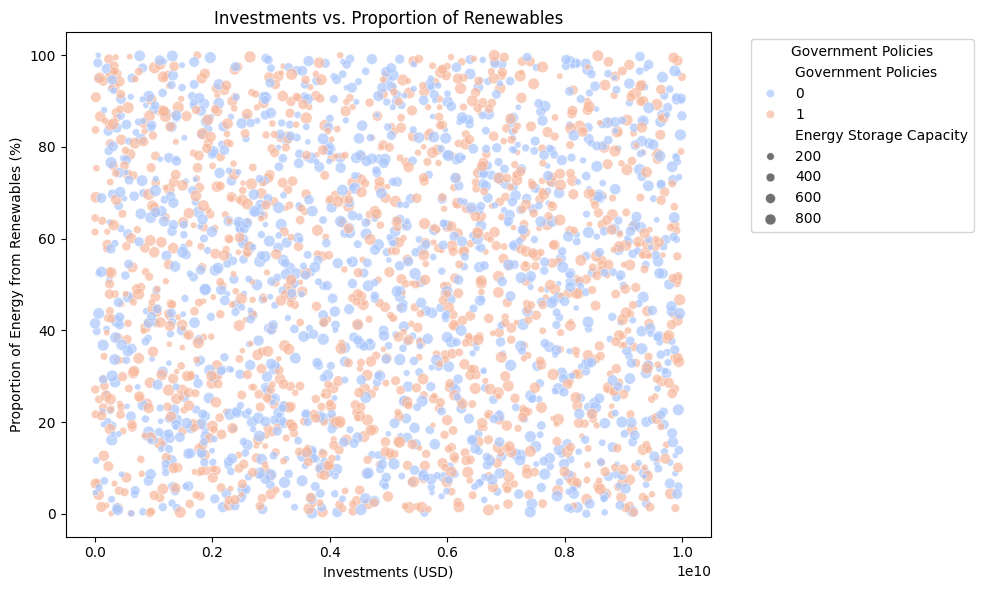

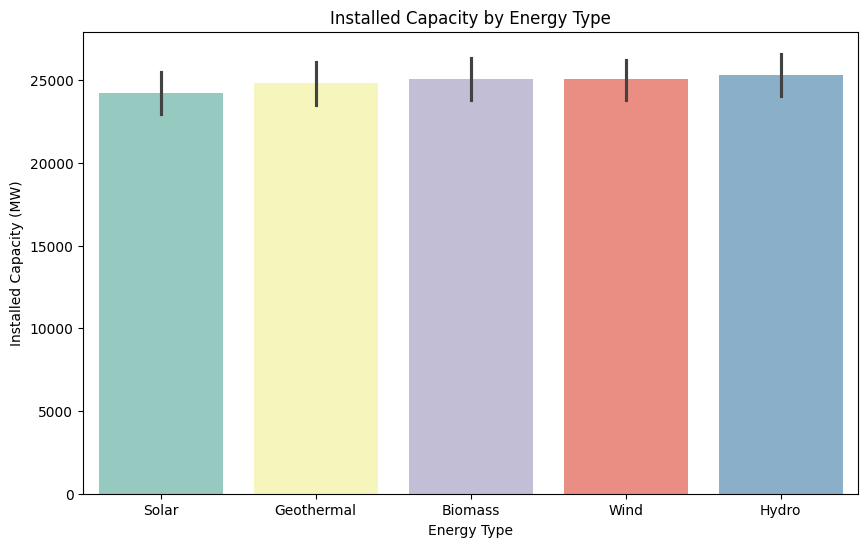


Regression Analysis Summary:
                                     OLS Regression Results                                     
Dep. Variable:     Proportion of Energy from Renewables   R-squared:                       0.002
Model:                                              OLS   Adj. R-squared:                  0.001
Method:                                   Least Squares   F-statistic:                     1.467
Date:                                  Tue, 10 Dec 2024   Prob (F-statistic):              0.222
Time:                                          14:25:19   Log-Likelihood:                -11956.
No. Observations:                                  2500   AIC:                         2.392e+04
Df Residuals:                                      2496   BIC:                         2.394e+04
Df Model:                                             3                                         
Covariance Type:                              nonrobust                                         


In [48]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import pearsonr
import statsmodels.api as sm

df = pd.read_csv('/content/drive/MyDrive/Dataset/complete_renewable_energy_dataset.csv')
critical_columns = ['Installed Capacity (MW)', 'Investments (USD)', 'Local Manufacturing Capacity', 'Proportion of Energy from Renewables', 'Government Policies', 'Energy Storage Capacity']
df_clean = df.dropna(subset=critical_columns)
descriptive_stats = df_clean[['Installed Capacity (MW)', 'Investments (USD)', 'Local Manufacturing Capacity', 'Proportion of Energy from Renewables', 'Government Policies', 'Energy Storage Capacity']].describe()


corr_installed, p_installed = pearsonr(df_clean['Installed Capacity (MW)'], df_clean['Proportion of Energy from Renewables'])
print(f"\nPearson Correlation between Installed Capacity and Proportion of Renewables: {corr_installed:.2f} (p-value: {p_installed:.4f})")

plt.figure(figsize=(10,6))
sns.scatterplot(x='Investments (USD)', y='Proportion of Energy from Renewables', hue='Government Policies', size='Energy Storage Capacity', data=df_clean, palette='coolwarm', alpha=0.7)
plt.title('Investments vs. Proportion of Renewables')
plt.xlabel('Investments (USD)')
plt.ylabel('Proportion of Energy from Renewables (%)')
plt.legend(title='Government Policies', bbox_to_anchor=(1.05,1), loc='upper left')
plt.tight_layout()
plt.show()

plt.figure(figsize=(10,6))
sns.barplot(x='Energy Type', y='Installed Capacity (MW)', data=df_clean, palette='Set3')
plt.title('Installed Capacity by Energy Type')
plt.xlabel('Energy Type')
plt.ylabel('Installed Capacity (MW)')
plt.show()

X = df_clean[['Investments (USD)', 'Local Manufacturing Capacity', 'Energy Storage Capacity']]
y = df_clean['Proportion of Energy from Renewables']
X = sm.add_constant(X)
model = sm.OLS(y, X).fit()
print("\nRegression Analysis Summary:")
print(model.summary())
